In [1]:
import os
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 2000)
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.transforms
plt.style.use('fivethirtyeight')

In [2]:
# Import relevant dataframes:

main_table = pd.read_csv(r"C:\Users\bob65\Documents\Summer2019_Research\PythonFiles\_Data\Brandeis_Main_Table_updated_7122019.csv")
print(len(main_table))
faculty_table = pd.read_csv(r"C:\Users\bob65\Documents\Summer2019_Research\PythonFiles\_Data\Brandeis_Dummy_Table_Updated_06192019.csv")
print(len(faculty_table))
skill_table = pd.read_csv(r"C:\Users\bob65\Documents\Summer2019_Research\PythonFiles\_Data\Brandeis_Skill_Table.csv")
print(len(skill_table))

3957167
3948821
36101672


In [7]:
def title_swap(string):
    dictionary = {'Community and Social Services':'Counseling and Religious Life',
                  'Customer and Client Support':'Online Support and University Information',
                  'Hospitality, Food, and Tourism':'Event Management and Hospitality', 
                  'Planning and Analysis':'Analysis', 
                  'Curriculum and Instructional Designer / Developer':'Curriculum and Instructional Designer', 
                  'Special Education Teacher':'Accessibility and Disability Services', 
                  'Teaching Assistant':'Faculty Support', 
                  'Tutor':'Academic Tutor'}
    if(string in dictionary):
        return dictionary[string] + ' [' + string + ']'
    else:
        return string

In [ ]:
growing_skills

In [20]:
full_table[(full_table['Occupation']=='Preschool / Childcare Teacher')&(full_table['Job Title']=='Lead Teacher')&(full_table['Year']==2017)].sort_values('IPEDS Institution Name')

,Unnamed: 0,Job ID,Year,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Institution Name,IPEDS Sector Name,R1,4-year,2-year,Public,Private
3469777,3469777,38188638813,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,16,18,1.00,-999.0,"Boston-Cambridge-Nashua, MA-NH",Massachusetts,Boston University,"Private not-for-profit, 4-year or above",1,1,0,0,1
3483526,3483526,38193059231,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,16,18,5.00,-999.0,"New York-Newark-Jersey City, NY-NJ-PA",New York,Columbia University in the City of New York,"Private not-for-profit, 4-year or above",1,1,0,0,1
3860979,3860979,38291366001,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,12,16,-83.25,-999.0,"Lebanon, NH-VT",New Hampshire,Dartmouth College,"Private not-for-profit, 4-year or above",1,1,0,0,1
3529845,3529845,38208024214,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,14,16,-83.25,23857.6,"Manhattan, KS",Kansas,Kansas State University,"Public, 4-year or above",1,1,0,1,0
3696805,3696805,38257595513,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,16,-999,1.00,-999.0,"Boston-Cambridge-Nashua, MA-NH",Massachusetts,Massachusetts Institute of Technology,"Private not-for-profit, 4-year or above",1,1,0,0,1
3627442,3627442,38239452702,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,16,-999,1.00,28008.0,"Columbus, OH",Ohio,Ohio State University-Main Campus,"Public, 4-year or above",1,1,0,1,0
3913192,3913192,38303491461,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,16,-999,1.00,27996.8,"Columbus, OH",Ohio,Ohio State University-Main Campus,"Public, 4-year or above",1,1,0,1,0
3636060,3636060,38241905472,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,16,-999,0.50,-999.0,"Tuscaloosa, AL",Alabama,The University of Alabama,"Public, 4-year or above",1,1,0,1,0
3883342,3883342,38296113651,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,16,-999,0.50,-999.0,"Tuscaloosa, AL",Alabama,The University of Alabama,"Public, 4-year or above",1,1,0,1,0
3943145,3943145,38310406233,2017,Lead Teacher,Preschool / Childcare Teacher,Education and Training,14,16,5.00,-999.0,"Colorado Springs, CO",Colorado,University of Colorado Denver/Anschutz Medical...,"Public, 4-year or above",1,1,0,1,0


In [9]:
def title_swap(string):
    dictionary = {'Community and Social Services':'Counseling and Religious Life',
                  'Customer and Client Support':'Online Support and University Information',
                  'Hospitality, Food, and Tourism':'Event Management and Hospitality', 
                  'Planning and Analysis':'Analysis', 
                  'Curriculum and Instructional Designer / Developer':'Curriculum and Instructional Designer', 
                  'Special Education Teacher':'Accessibility and Disability Services', 
                  'Teacher Assistant':'Faculty Support', 
                  'Tutor':'Academic Tutor'}
    if(string in dictionary):
        return dictionary[string] + ' [' + string + ']'
    else:
        return string

In [43]:
###############################################
# Distribution of 2017 Non-Faculty PhD Postings
###############################################

# Method:

# This visualization is designed to help us look at the large scale distribution of Non-Faculty Postings
# in higher education. We do this by comparing the relative sizes of the major Career Areas in this
# category. For this particular visualization I chose to use only the 4-Year institutions in 2017. 
# # However, this process can be completed with any of the usual filters we apply here. It is important
# that we continue to  use the Non-Faculty postings for these visualizations since the career area of 
# Education and Training is the only one for Faculty postings and that offers us no useful information.

# (1) Merge in the relevant data from the faculty table: In this case all that is needed was the Faculty
#     column so that Faculty == 1 observations can be filtered out.

# (2) Apply Generalized Filters: This is the stage where I select the more general filters to pare these
#     data down by. We choose data from 2017, that is Non-Faculty, and from 4-Year Universities. The
#     next filter is the important filter for obtaining the PhD postings that we are looking for. 
#     Originally we had checked both the minimum and maximum required columns for the value of 21 to
#     obtain PhD postings, and this is the method you might have read in the best practices manual. We 
#     have discovered, however, that this is including many postings that are not aimed at PhD holders.
#     Therefore, in this visualization and those in the future, please use the 
#     [Minimum EDU Requirements == 21] filter.

# (3) Problem Avoidance Filters: These filters are put in place because they remove observations from the
#     dataset that were causing problems for us. This includes the typical removal of Healthcare jobs
#     (Note that we ignore Health sciences since these are Non-Faculty postings), and then removes Null
#     career area postings as well. The next selection of filters is amimed at removing a series of job
#     types that typically do not have PhDs but rather MDs or JDs. They are obviously listed below, but I 
#     will put together a little list here for you. We remove observations based on filters in the 
#     Job Title, Occupation, Career Area, and IPEDS Institution Name columns (Note that Institution is 
#     misspelled 'Insitution' in the main table. This has caused me a lot of headaches not understanding
#     why my queries wouldn't work.) Here are the removal filters broken down by the column they operate 
#     on: (A given observation is to be removed if any of the following are true about it)

# Career Area:
#     Contains 'attorney'
#     Contains 'financial manager'
    
# Occupation:
#     Contains 'attorney'
#     Contains 'financial manager'
    
# Job Title:
#     Contains 'title IX'
#     Contains 'Director of Advancement'
#     Contains 'finance manager'
#     Contains 'financial manager'
    
# IPEDS Insitution Name: [Institution]
#     Contains 'law'
#     Contains 'medical'

# (1) Merge Tables
full_table = main_table.merge(faculty_table[['Job ID', 'Faculty']], how='inner', on='Job ID')

# (2) General Filters
full_table = full_table[full_table['Year']==2017]
full_table = full_table[full_table['Faculty'] == 0]
full_table = full_table[full_table['4-year'] == 1]
full_table = full_table[(full_table['Minimum EDU Requirements']==21)]

# (3) Problem Avoidance Filters
full_table = full_table[(full_table['Career Area']!='Health Care including Nursing')&(full_table['Career Area']!='na')]

# These Job Titles are omitted because they are likely to hold JD or MD rather than PhD

full_table = full_table[~(full_table['Career Area'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('attorney', case=False, na=False)) & 
                        ~(full_table['Job Title'].str.contains('title ix', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('director of advancement', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('finance manager', case=False, na=False)) & 
                        ~(full_table['Job Title'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Career Area'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['IPEDS Institution Name'].str.contains('law', case=False, na=False)) & 
                        ~(full_table['IPEDS Institution Name'].str.contains('medical', case=False, na=False))]


In [47]:
# When defining the pie chart only Career Areas that represent more that 1% of
# the total amount of postings will be given their own slice. The rest are 
# consolidated into the 'other' category.

def pie(df, title):
    areas = list()
    counts = list()
    total = 0
    for index, row in df.iterrows():
        total += row[1]
        areas.append(row[0])
        counts.append(row[1])
        
    areas = np.array(areas)
    counts = np.array(counts)
    counts = np.true_divide(counts, total)
    
    first_below = True # Is this the first observation to fall below the 1% threshold?
    index_of_other = 0
    for i in range(len(counts)):
        if counts[i] < 0.01:
            if first_below:
                index_of_other = i
                areas[i] = 'Other'
                first_below = False
            else:
                counts[index_of_other] += counts[i]
                
    counts = counts[:index_of_other + 1]
    areas = areas[:index_of_other + 1]
    
    plt.pie(x=counts, labels=areas, radius = 2, rotatelabels = True, autopct='%.1f', pctdistance = 0.8, shadow=True)
    plt.title(title, pad=175, loc='center')

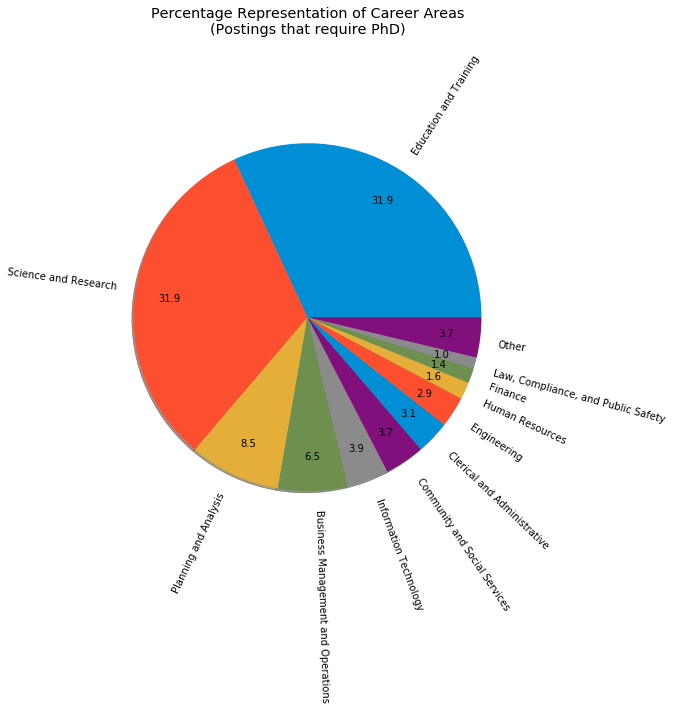

In [48]:
pie(pd.DataFrame(full_table['Career Area'].value_counts()).reset_index(), 'Percentage Representation of Career Areas\n(Postings that require PhD)')

In [11]:
occupations = pd.DataFrame(full_table['Occupation'].value_counts())[:15]
occupations

,Occupation
Research Associate,649
Dean of Academic Division,496
"Administrator, Higher Education",365
Research Scientist,309
Medical Research Scientist,216
Dean of Academic Affairs,175
"Associate Dean, Higher Education",166
Social Science Researcher,161
"Program Director, Higher Education",157
Academic / Guidance Counselor,127


In [176]:
for index, row in occupations.iterrows():
    print(index,'\n',pd.DataFrame(full_table[full_table['Occupation']==index]['Job Title'].value_counts())[:6],'\n')

Research Associate 
                                                     Job Title
Research Assistant Professor                               92
Research Associate                                         73
Research Scholar                                           16
Research Specialist                                        15
Senior Researcher                                          11
Research Assistant/Associate/Full Professor - I...          8 

Dean of Academic Division 
                                                   Job Title
Chair                                                    14
Department Chair                                         13
Dean, School Of Law                                       6
Associate Dean For Education                              5
Dean Of The College Of Business                           5
Assistant Dean And Director Of General Education          4 

Administrator, Higher Education 
                                                     Job Tit

In [35]:
# Analysis of 2007-2017 PhD Postings

full_table = main_table.merge(faculty_table[['Job ID', 'Faculty']], how='inner', on='Job ID')

full_table = full_table[(full_table['Year']==2017)]
full_table = full_table[full_table['Faculty'] == 0]
full_table = full_table[full_table['4-year'] == 1]
full_table = full_table[(full_table['Minimum EDU Requirements']==21)]
# full_table = full_table[(full_table['Career Area']!='Health Care including Nursing')&(full_table['Career Area']!='na')]

# Omitted Job Titles likely due to JD or MD rather than PhD


full_table = full_table[~(full_table['Career Area'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('attorney', case=False, na=False)) & 
                        ~(full_table['Career Area']=='na') &
                        ~(full_table['Job Title'].str.contains('title ix', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('director of advancement', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('finance manager', case=False, na=False)) & 
                        ~(full_table['Job Title'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Career Area'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['IPEDS Institution Name'].str.contains('law', case=False, na=False)) & 
                        ~(full_table['IPEDS Institution Name'].str.contains('medical', case=False, na=False))]

print(len(full_table))

8459


In [36]:
career = full_table['Career Area'].value_counts()
sum = 0
for number in career:
    sum+=number
    print(sum)
print('\t', sum)

print(career)

2521
4467
6215
6788
7164
7426
7664
7854
8039
8131
8201
8252
8298
8343
8381
8409
8422
8434
8444
8451
8454
8456
8458
8459
	 8459
Health Care including Nursing                 2521
Education and Training                        1946
Science and Research                          1748
Planning and Analysis                          573
Business Management and Operations             376
Community and Social Services                  262
Information Technology                         238
Clerical and Administrative                    190
Engineering                                    185
Human Resources                                 92
Law, Compliance, and Public Safety              70
Finance                                         51
Design, Media, and Writing                      46
Marketing and Public Relations                  45
Sales                                           38
Manufacturing and Production                    28
Hospitality, Food, and Tourism                  13
Perfor

In [39]:
final = pd.DataFrame()
i = 0
career_areas = pd.DataFrame(full_table['Career Area'].value_counts()).reset_index()['index'].values
for career in career_areas[:10]:
    occupations = pd.DataFrame(full_table[full_table['Career Area']==career]['Occupation'].value_counts()).reset_index()['index'].values
    print(career, ' (' + str(i) + '-' + str(i+99) + ')')
    for occupation in occupations[:10]:
        print('\t', occupation, ' (' + str(i) + '-' + str(i+9) + ')')
        i+=10
        final = final.append(full_table[(full_table['Career Area']==career)&(full_table['Occupation']==occupation)][:10], ignore_index=True)
    print('\n')
    
final.to_excel(r"C:\Users\bob65\Documents\Summer2019_Research\PythonFiles\_Data\PhD_Required_Preview.xls")

Health Care including Nursing  (0-99)
	 Physician, Other  (0-9)
	 Psychologist  (10-19)
	 General Internist  (20-29)
	 Clinical Pharmacist  (30-39)
	 Healthcare Administrator  (40-49)
	 Psychiatrist  (50-59)
	 Surgeon  (60-69)
	 Clinical Supervisor / Manager  (70-79)
	 Family / General Practitioner  (80-89)
	 Neurologist  (90-99)


Education and Training  (100-199)
	 Dean of Academic Division  (100-109)
	 Administrator, Higher Education  (110-119)
	 Dean of Academic Affairs  (120-129)
	 Associate Dean, Higher Education  (130-139)
	 Program Director, Higher Education  (140-149)
	 Provost  (150-159)
	 Librarian  (160-169)
	 Elementary School Teacher  (170-179)
	 Vocational Education Instructor  (180-189)
	 Director of Student Affairs  (190-199)


Science and Research  (200-299)
	 Research Associate  (200-209)
	 Research Scientist  (210-219)
	 Social Science Researcher  (220-229)
	 Physicist  (230-239)
	 Chemist (General)  (240-249)
	 Biological Technician  (250-259)
	 Graduate Research F

In [14]:
###################################
# Fastest Growing Jobs in Higher ED
###################################

full_table = main_table.merge(faculty_table[['Job ID', 'Health sciences', 'Number of Detailed Fields of Study']], how='inner', on='Job ID')

full_table = full_table[(full_table['Year']==2007)|(full_table['Year']==2017)]
full_table = full_table[full_table['4-year'] == 1]
# full_table = full_table[(full_table['Maximum EDU Requirements']==21)|(full_table['Minimum EDU Requirements']==21)]
full_table = full_table[(full_table['Career Area']!='Health Care including Nursing')&(full_table['Career Area']!='na')]
full_table = full_table[((full_table['Health sciences'] != 1) | (full_table['Number of Detailed Fields of Study'] > 1))]

occ_07=pd.DataFrame(full_table[full_table['Year']==2007]['Occupation'].value_counts()).reset_index()
occ_17=pd.DataFrame(full_table[full_table['Year']==2017]['Occupation'].value_counts()).reset_index()

total_occ = occ_17.merge(occ_07, on='index', how='inner')

total_occ['%Change'] = np.true_divide(-1 * (total_occ['Occupation_y'].values - total_occ['Occupation_x'].values), total_occ['Occupation_y'].values) * 100

total_occ.sort_values(['%Change'], inplace=True)
# Omitted Job Titles likely due to JD or MD rather than PhD


In [22]:
total_occ[(total_occ['Occupation_x']>=100)&(total_occ['Occupation_y']>=10)]

,index,Occupation_x,Occupation_y,%Change
192,Nanny / Babysitter,275,645,-57.364341
266,Director of Religious Education,167,287,-41.811847
84,Secretary,681,1042,-34.644914
336,Office Technician / Typist,114,168,-32.142857
106,Chaplain / Pastor / Priest,549,759,-27.667984
138,Computer Programmer,404,555,-27.207207
321,Safety Specialist,126,165,-23.636364
338,Network Analyst / Specialist,113,141,-19.858156
291,Auditor (General),144,173,-16.763006
74,Programmer / Analyst,757,893,-15.229563


In [8]:
full_table = main_table.copy()

len(full_table[full_table['Job Title'].str.contains('Social Policy', case=False, na=False)])

65

In [21]:
##########################################################################
# Skill Clusters Requested by Career Counseling Jobs at 4-Year Instiutions
##########################################################################

# Method:
# This was a relatively easy visualization to recreate. The only new thing that is inculded
# here that has not been before is the usage of the skill_table. If you try to use the
# skill_table on your personal machine I suggest that you perform merges in a way similar to
# what I have done here. This involves pre-trimming the two dataframes based on the filters
# that are relevant to only them, and then generating your final table off of an inner merge
# of Job IDs from both of them. This will get you observations that only fit both filters,
# and will save a large amount of your time as well as utilize RAM in the most efficient way.

# With that digression aside here is the methodology:
# (1) Filter Data:
#     In this case we need a few filters. We need to choose the occupation to be 'Career
#     Counselor', we need the observations to be from 4-year insitutions, and we need data
#     from only 2007 and 2017. There are no filters that we apply to the skill_table in this
#     case.
    
# (2) Generate Skill Cluster Counts:
#     As you can see this step involves a large compilation of method calls in one line of 
#     code. Both are identical, so I will explain one of them here with the example code:
    
#     clusters_07 = pd.DataFrame(
#         full_table[full_table['Year']==2007]['Skill Cluster Name'].value_counts()).reset_index().rename(
#         columns={'Skill Cluster Name':'count'})
    
#     The command starts with "full_table[full_table['Year']==2007]['Skill Cluster Name']."
#     In this snippet I isolate the data to be from 2007 and to return only the Skill
#     Cluster Name column; ".value_counts()" then retrieves the counting of all categories
#     so that their relative sizes can be compared; I then convert this object into a
#     DataFrame with the "pd.DataFrame(...)" command, and reset the index so that the
#     cluster names can be treated like any other column based variable. Finally as an
#     artifact of how DataFrame conversion works, I must rename the column for it to reflect
#     what it truly represents.
    
# (3) Calculate Adjusted Share of Jobs:
#     The adjusted share of jobs represnts how big each individual skill is relative to the
#     largest skill category in the sample. This entails dividing all skills in the sample
#     by the largest represented skill, and then multiplying this by 100 to obtain the
#     relative size. This must be done when comparing data from 2007 with any other year,
#     and is done to eliminate the bias that would enter when considering the 
#     underrepresentation of certain skills in this early data. Since we are comparing data
#     from 2007 and 2017 we must perform this adjustment. We will then determin growth rates
#     from the relative changes from year to year in these values.
    
# (4) Calculate Growth:
#     This is straight-forward. I merged the tables together on their skill cluster titles.
#     Once this is done you can simply calculate the growth in the adjusted share from 2007
#     to 2017.
    
# (5) Clean Up and Clarify Data:
#     I have included this step simply to make my DataFrame more readable. I sort the data
#     in a descending order, and change the name of some columns. While it is important
#     to sort the data in this way, whether or not you need to perform the other steps is
#     for your visualization is entirely up to you.
    
# It seems to me that the best way to show them growth of fields visually might be to
# graph the growth rates individually. This is beacuse so many of these categories have
# sizes of one (hence why their growth is so high), and would be washed out in a
# comparative bar chart by the 2017 observations that are in the hundreds. Ideally from the
# customization standpoint the end user should be able to choose any occupation and have
# the visualization produced for them the same way that it is here.

# (1) Filter Data
full_table = main_table.copy()

full_table = full_table[full_table['Occupation']=='Administrator, Higher Education']
# full_table = full_table[full_table['4-year']==1]
full_table = full_table[(full_table['Year']==2007)|(full_table['Year']==2017)]

full_table = full_table.merge(skill_table[['Job ID', 'Skill Name', 'Is Specialized Skill?', 'Is Software Skill?',
                                           'Skill Cluster Name']], on='Job ID', how='inner')

# (2) Generate Skill Cluster Counts
clusters_07 = pd.DataFrame(full_table[full_table['Year']==2007]['Skill Cluster Name'].value_counts()).reset_index().rename(
    columns={'Skill Cluster Name':'count'})

clusters_17 = pd.DataFrame(full_table[full_table['Year']==2017]['Skill Cluster Name'].value_counts()).reset_index().rename(
    columns={'Skill Cluster Name':'count'})

# (3) Calculate Adjusted Share of Jobs
def adjust_share_of_jobs(df):
    top_skill = df[:1]['count']
    df['adjusted_share'] = round(np.true_divide(df['count'], top_skill) * 100, 2)

adjust_share_of_jobs(clusters_07)
adjust_share_of_jobs(clusters_17)

# (4) Calculate Growth
final = clusters_17.merge(clusters_07, on='index', how='inner')
final['growth'] = round((np.true_divide(final['adjusted_share_x']-final['adjusted_share_y'], final['adjusted_share_y']))
                        * 100, 2)

# (5) Clean Up and Clarify Data
final.rename(columns={'count_x':'count_17', 'count_y':'count_07'}, inplace=True)
# This line returns the final DataFrame of interest
final.sort_values(by='growth', ascending=False).drop(columns=['adjusted_share_x', 'adjusted_share_y'])[:10]

NameError: name 'skill_table' is not defined

In [26]:
# This is the left half of the visualization. I perform it second here since 
# it is trivial to do once you have already done the calucations for step 2.
clusters_17[:10]

,index,count,adjusted_share
0,Microsoft Office and Productivity Tools,469,100.00
1,Social Media,306,65.25
2,Education Administration,220,46.91
3,Teaching,206,43.92
4,Higher Education,147,31.34
5,General Administrative and Clerical Tasks,110,23.45
6,Basic Customer Service,110,23.45
7,Public Relations,109,23.24
8,Human Resource Management and Planning,106,22.60
9,Scheduling,100,21.32


In [58]:
#################################################################################################
# Mental and Behavioral Health Specialties: Which career areas are requesting this skill cluster?
#################################################################################################

# Method:
# This slide is very simple to recreate. For information about best practices when
# using skil_table data, see the slide methodology for "Skill Clusters Requested 
# by Career Counseling Jobs at 4-Year Instiutions."

# (1) Apply Filters:
#     In this case we only want postings that request skills in the cluster Mental
#     and Behavioral Health Specialities. We also only want postings from 2007 and
#     2017 that are from 4-year institutions (obviously these are up to being
#     customized once they are implemented on the site).
    
# (2) Generate Career Area Counts:
#     This step lets us generate the tables that will be used too create the graphs.
#     They are simply counts of the number of postings that are within each career
#     area with the above filters applied. For details on the structure of these 
#     individual lines of code, see the above mentioned slide methodology under 
#     section (2). It is also important to note that the career area of 'na' is
#     omitted since it offers no information in this visualization. This group of
#     postings is quite interesting, yet they are not related as this aggregate
#     grouping might suggest.
    
# (3) Calculate Growth Rates:
#     This is a simple groth rate calculation that is performed by merging the two
#     DataFrames and then calcualting a percentage change over the two years. Also
#     note that Career Areas with fewer than 400 postings in 2017 are omitted from
#     this analysis.
    
# (1) Apply Filters
full_table = skill_table[skill_table['Skill Cluster Name']=='Mental and Behavioral Health Specialties']
other_table = main_table[(main_table['Year']==2007)|(main_table['Year']==2017)]
other_table = other_table[other_table['4-year']==1]

full_table = full_table.drop(columns='Year').merge(other_table, on='Job ID', how = 'inner')

# (2) Generate Career Area Counts
careers_07 = pd.DataFrame(full_table['Career Area'][full_table['Year']==2007].value_counts()).reset_index().rename(
    columns={'Career Area':'count'})
careers_07 = careers_07[~(careers_07['index']=='na')]

careers_17 = pd.DataFrame(full_table['Career Area'][full_table['Year']==2017].value_counts()).reset_index().rename(
    columns={'Career Area':'count'})
careers_17 = careers_17[~(careers_17['index']=='na')]

# (3) Calculate Growth Rates
final = careers_07.merge(careers_17, on='index', how='inner')
final.rename(columns={'count_x':'count_07', 'count_y':'count_17'}, inplace=True)
final['growth'] = round(np.true_divide(final['count_17']-final['count_07'], final['count_07']) * 100, 2)
final = final[final['count_17']>400]
final.sort_values(by='growth', ascending=False)[:5] # This returns the final DataFrame

,index,count_07,count_17,growth
7,Human Resources,79,718,808.86
2,Community and Social Services,735,4342,490.75
5,Business Management and Operations,172,803,366.86
6,Planning and Analysis,135,621,360.00
1,Health Care including Nursing,2189,8563,291.18


In [57]:
# This is the lefthand side of the visualization. Its completion
# is trivial if it is performed after the calculations for the righthand
# side have already been performed. That is why it is done second here.
careers_17[:5]

,index,count
0,Education and Training,8772
1,Health Care including Nursing,8563
2,Community and Social Services,4342
4,Science and Research,1688
5,Clerical and Administrative,924


In [5]:
#############################################################
# Non-Faculty Job Postings in Higher Education Requiring PhDs
#############################################################

# This visualization was somewhat complex to recreate due to the sheer number of moving
# parts contained within it. It both reuses previous code, but also develops some new 
# methods for expediently merging and analyzing these large dataframes.

# Method:

# (1) Merge Tables:
#     In this case, all that we need from the faculty table is the Faculty dummy in
#     order to isolate the non-faculty postings.
    
# (2) General Filters:
#     Since we are calculating growth rates in this scenario we need two years of 
#     observation: 2010 and 2017. This means that we don't need to employ the method of
#     adjusted share of jobs that we outlined on Friday 7/19. We will however use a 
#     different method for ensuring valid comparison. Other filters in this section are
#     the faculty, 4-year (optional), and restriction of Min EDU Requirements to 21
#     years.
    
# (3) Problem Avoidance Fitlers:
#     These are the usual removals and are something that you will be familiar with by
#     now. Refer to section 3 of Method in "Distribution of 2017 Non-Faculty PhD 
#     Postings"
    
# (4) Analyze Skill Data:
#     It is important to note that both the full_table and the skill_table are reduced 
#     to as small a size as is possible before merging in order to decrease computational
#     resources that must be devoted to the process. These two methods output the
#     information that is essentially the finished product for the visualization.

# (1) Merge Tables
full_table = main_table.merge(faculty_table[['Job ID', 'Faculty']], how='inner', on='Job ID')

# (2) General Filters
full_table = full_table[(full_table['Year']==2010)|(full_table['Year']==2017)]
full_table = full_table[full_table['Faculty'] == 0]
full_table = full_table[full_table['4-year'] == 1]
full_table = full_table[(full_table['Minimum EDU Requirements']==21)]

# (3) Problem Avoidance Filters
full_table = full_table[(full_table['Career Area']!='Health Care including Nursing')&(full_table['Career Area']!='na')]

# These Job Titles are omitted because they are likely to hold JD or MD rather than PhD

full_table = full_table[~(full_table['Career Area'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('attorney', case=False, na=False)) & 
                        ~(full_table['Job Title'].str.contains('title ix', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('director of advancement', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('finance manager', case=False, na=False)) & 
                        ~(full_table['Job Title'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Career Area'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['IPEDS Institution Name'].str.contains('law', case=False, na=False)) & 
                        ~(full_table['IPEDS Institution Name'].str.contains('medical', case=False, na=False))]
#####################################################################################


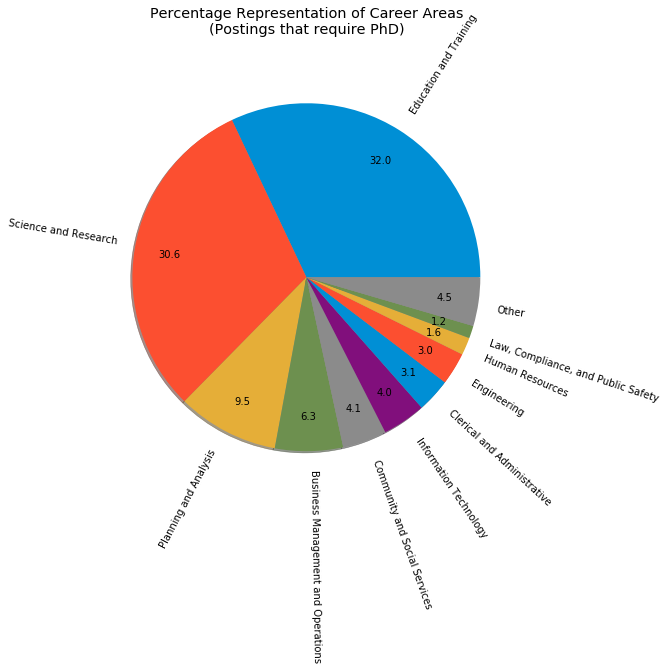

In [5]:
# Share of Non-Faculty Openings Requiring PhD at 4-Years in 2017
# You will note that this pie chart is identical to the one that was presented
# on 7/19. The code is the same, but is repeated here so that the script
# contains all code required for the replication of the visualization.

def pie(df, title):
    areas = list()
    counts = list()
    total = 0
    for index, row in df.iterrows():
        total += row[1]
        areas.append(row[0])
        counts.append(row[1])
        
    areas = np.array(areas)
    counts = np.array(counts)
    counts = np.true_divide(counts, total)
    
    first_below = True # Is this the first observation to fall below the 1% threshold?
    index_of_other = 0
    for i in range(len(counts)):
        if counts[i] < 0.01:
            if first_below:
                index_of_other = i
                areas[i] = 'Other'
                first_below = False
            else:
                counts[index_of_other] += counts[i]
                
    counts = counts[:index_of_other + 1]
    areas = areas[:index_of_other + 1]
    
    plt.pie(x=counts, labels=areas, radius = 2, rotatelabels = True, autopct='%.1f', pctdistance = 0.8, shadow=True)
    plt.title(title, pad=175, loc='center')
#####################################################################################    
    
pie(pd.DataFrame(full_table[full_table['Year']==2017]['Career Area'].value_counts()).reset_index(),
    'Percentage Representation of Career Areas\n(Postings that require PhD)')

In [9]:
# Largest Occupations Requiring PhDs at 4-years in 2017:
#     This is simply performed by querying the DataFrame for the top occupations and 
#     then truncating the returned set to only view the top 8 occupations.
top_jobs = pd.DataFrame(full_table[full_table['Year']==2017]['Occupation'].value_counts()).reset_index().rename(columns={
    'Occupation':'count'})[:8]
# This returned table is then used in the next two methods to determine which 
# occupations should be searched within.
top_jobs

,index,count
0,Research Associate,763
1,Dean of Academic Division,528
2,"Administrator, Higher Education",392
3,Research Scientist,383
4,Medical Research Scientist,210
5,"Associate Dean, Higher Education",180
6,Dean of Academic Affairs,179
7,Social Science Researcher,170


In [10]:
# (4) Analyze Skill Data

# This function queries the skill table for the top 10 skills within each occupation
# in the order in which they occurred in the top_jobs table.
def top_skills(full_df, jobs_df):
    full_df = full_df[full_df['Year']==2017]
    skills = skill_table[skill_table['Year']==2017]
    for index, row in jobs_df.iterrows():
        # row['index'] refers to the string that represents the occupation title of
        # that given row.
        temp = full_df[full_df['Occupation']==row['index']]
        temp = temp.merge(skills.drop(columns='Year'), on='Job ID', how='inner')
        print('\t' + row['index'] + '\n\n', pd.DataFrame(temp['Skill Cluster Name'].value_counts()).reset_index(
        ).rename(columns={'Skill Cluster Name':'count', 'index':'Skill Cluster Name'})[:10], '\n')

# This function performs a similar query to the previous one, but calculates the growth
# rate of each of the skills, and then sorts them by their highest rates. Due to the
# fact that different numbers of observations are present from the two different years
# I have divided the entire column of counts by the TOTAL QUANTITY of jobs rather than
# simply the number of jobs in the top skill. This allows the relative shares of the
# top skill cluster to be compared as well as those of the other skills.
def growing_skills(full_df, jobs_df):
    skills = skill_table[(skill_table['Year']==2010)|(skill_table['Year']==2017)]
    for index, row in jobs_df.iterrows():
        # row['index'] refers to the string that represents the occupation title of
        # that given row.
        temp = full_df[full_df['Occupation']==row['Occupation']]
        temp_10 = temp[temp['Year']==2010]
        temp_17 = temp[temp['Year']==2017]
        # Deletions are performed to save memory
        del(temp)
        
        temp_10 = temp_10.merge(skill_table[skill_table['Year']==2010].drop(columns='Year'), on='Job ID', how='inner')
        count_10 = temp_10['Job ID'].nunique()
        temp_10 = pd.DataFrame(temp_10['Skill Cluster Name'].value_counts()).reset_index().rename(
            columns={'Skill Cluster Name':'count'})
        temp_10['count'] = np.true_divide(temp_10['count'], count_10)

        temp_17 = temp_17.merge(skill_table[skill_table['Year']==2017].drop(columns='Year'), on='Job ID', how='inner')
        count_17 = temp_17['Job ID'].nunique()
        temp_17 = pd.DataFrame(temp_17['Skill Cluster Name'].value_counts()).reset_index().rename(
            columns={'Skill Cluster Name':'count'})
        temp_17['count'] = np.true_divide(temp_17['count'], count_17)

        temp = temp_10.merge(temp_17, on='index', how='inner')
        del(temp_10, temp_17)
        
        temp['growth'] = round(np.true_divide(temp['count_y']-temp['count_x'], temp['count_x']) * 100, 2)
        temp = temp.sort_values(by='growth', ascending=False).reset_index(drop=True)
        temp.rename(columns={'index':'Skill Cluster Name', 'count_x':'share_10', 'count_y':'share_17'}, inplace=True)
        print('\t' + row['Occupation'] + '\n\n', temp[:10], '\n')        

In [ ]:
full_table = main_table[main_table['Occupation']=='Administrator, Higher Education'].merge(faculty_table[faculty_table['Faculty']!=1])
jobs = full_df['Occupation']
growing_skills(main_table, )

In [35]:
top_skills(full_table, top_jobs)

	Research Associate

      Skill Cluster Name  count
0              Genetics    241
1  Research Methodology    219
2               Writing    165
3               Biology    164
4              Teaching    157
5     Molecular Biology    152
6      Cellular Biology    151
7         Data Analysis    146
8   Laboratory Research    128
9             Chemistry    111 

	Dean of Academic Division

                          Skill Cluster Name  count
0                                  Teaching    420
1                         Budget Management    310
2                         Business Strategy    174
3                         People Management    147
4                               Fundraising    116
5                        Program Management    105
6       Instructional and Curriculum Design     89
7                  Education Administration     66
8                                Scheduling     54
9  Mental and Behavioral Health Specialties     51 

	Administrator, Higher Education

         

In [50]:
growing_skills(full_table, top_jobs)

	Research Associate

                   Skill Cluster Name  share_10  share_17   growth
0                   Machine Learning  0.001887  0.048493  2470.12
1  Obstetrics and Gynecology (OBGYN)  0.003774  0.031455   733.55
2                          Neurology  0.005660  0.044561   687.24
3                  Child Development  0.001887  0.014417   664.09
4             Performance Management  0.001887  0.013106   594.63
5                 Basic Patient Care  0.005660  0.032765   478.86
6   Equipment Repair and Maintenance  0.001887  0.009174   386.24
7                      Cybersecurity  0.001887  0.007864   316.78
8                          Scripting  0.001887  0.007864   316.78
9                           Robotics  0.003774  0.015727   316.78 

	Dean of Academic Division

                          Skill Cluster Name  share_10  share_17  growth
0                             Data Analysis  0.003534  0.018939  435.98
1                        Project Management  0.007067  0.032197  355.59
2    

,index,count_10,count_17,growth
0,School Principal,8,66,725.00
1,Student Support Administrator,4,24,500.00
2,Music Teacher,4,21,425.00
3,Substitute Teacher,7,32,357.14
4,Special Education Teacher,99,423,327.27
5,Director of Student Affairs,115,484,320.87
6,Campus Director,13,46,253.85
7,Superintendent (Education),9,31,244.44
8,Residential Services Administrator,74,251,239.19
9,Umpire / Referee,8,27,237.50


In [6]:
# (4) Analyze Skill Data

# This function queries the skill table for the top 10 skills within each occupation
# in the order in which they occurred in the top_jobs table.
def career_skill_breakdown(full_df, jobs_df):
    skills = skill_table[(skill_table['Year']==2010)|(skill_table['Year']==2017)]
    for index, row in jobs_df.iterrows():
        # row['index'] refers to the string that represents the occupation title of
        # that given row.
        print('\tOccupation: ' + row['index'])
        
        temp = full_df[full_df['Occupation']==row['index']]
        temp = temp.merge(skills.drop(columns='Year'), on='Job ID', how='inner')
        print('\t\t' + 'Top Skills: ' + '\n')
        display(pd.DataFrame(temp['Skill Cluster Name'].value_counts()).reset_index(
        ).rename(columns={'Skill Cluster Name':'count', 'index':'Skill Cluster Name'})[:10])
        print()
        
        temp = full_df[full_df['Occupation']==row['index']]
        temp_10 = temp[temp['Year']==2010]
        temp_17 = temp[temp['Year']==2017]
        # Deletions are performed to save memory
        del(temp)
        
        temp_10 = temp_10.merge(skill_table[skill_table['Year']==2010].drop(columns='Year'), on='Job ID', how='inner')
        count_10 = temp_10['Job ID'].nunique()
        temp_10 = pd.DataFrame(temp_10['Skill Cluster Name'].value_counts()).reset_index().rename(
            columns={'Skill Cluster Name':'count'})
        temp_10['count'] = np.true_divide(temp_10['count'], count_10)

        temp_17 = temp_17.merge(skill_table[skill_table['Year']==2017].drop(columns='Year'), on='Job ID', how='inner')
        count_17 = temp_17['Job ID'].nunique()
        temp_17 = pd.DataFrame(temp_17['Skill Cluster Name'].value_counts()).reset_index().rename(
            columns={'Skill Cluster Name':'count'})
        temp_17['count'] = np.true_divide(temp_17['count'], count_17)

        temp = temp_10.merge(temp_17, on='index', how='inner')
        del(temp_10, temp_17)
        
        temp['growth'] = round(np.true_divide(temp['count_y']-temp['count_x'], temp['count_x']) * 100, 2)
        temp = temp.sort_values(by='growth', ascending=False).reset_index(drop=True)
        temp.rename(columns={'index':'Skill Cluster Name', 'count_x':'share_10', 'count_y':'share_17'}, inplace=True)
        print('\t\t' + 'Fastest Growing Skills: ' + '\n')
        display(temp[:10])
        print()


                

In [13]:
#############################################
# Replacement for PhD Slide
# Career Area Occupation and Skill Breakdowns
#############################################

# Hi Nina, the methodology here is not too bad since Jessica and I decided to greatly pare down
# the amount of information that this slide will put out. I will, therefore, provide in-line
# commenting rather than the typical methodology breakdown.

# Just as a side note to begin, the function of this slide is to break down 5 Career Areas in 
# a way that shows us the top 10 Occupations in 2010 and 2017. Then we show the top skills in
# the top occupation of 2017. Fairly simple stuff!

# To begin all we need is a verison of the main_table
full_table = main_table.copy()

# Filter the years to make the merging faster and more simple
full_table = full_table[(full_table['Year']==2010)|(full_table['Year']==2017)]

# Jessica and I wanted to look closer at the R1 institutions, but you add this as an interactive
# option
full_table = full_table[full_table['R1']==1]

full_table = full_table.merge(faculty_table[faculty_table['Faculty']==0].drop(columns='Year'), on='Job ID', how='inner')

# These are the Career Areas that we want to break down by. It's a simple list that is used to
# iterate over.
careers = ['Education and Training', 'Science and Research', 'Community and Social Services',
           'Business Management and Operations', 'Planning and Analysis']

# For each Career Area
for career in careers:
    
    # Filter the table into a temporary table that has only the current Career Area
    aux_table = full_table[(full_table['Career Area']==career)]

    # Create dataframes that represent the top occupations in each year. This is something that we
    # have done before, but simply filters the table for the specific year and then performs a
    # value count of the Occupations. This will make a sorted pandas series that can be passed into
    # the constructor for a DataFrame. I then do some renaming to make it easier to read.
    occ_10 = pd.DataFrame(aux_table[aux_table['Year']==2010]['Occupation'].value_counts()).reset_index().rename(
        columns={'Occupation':'count_10', 'index':'Occupation'})
    occ_17 = pd.DataFrame(aux_table[aux_table['Year']==2017]['Occupation'].value_counts()).reset_index().rename(
        columns={'Occupation':'count_17', 'index':'Occupation'})
    
    # Print the Career Area
    print('Career Area: ' + career)
    
    # Display the occupation tables (display() is a Jupyter Notebook specific command that prints
    # the dataframe in a more attractive way)
    print('\tTop 10 Occupations 2010: ')
    display(occ_10[:10])
    print('\tTop 10 Occupations 2017: ')
    display(occ_17[:10])
    
    growing_skills(aux_table, occ_17[:10])
    
    # Print the Occupation that we are breaking down the skills for
    # (Explanation of: occ_17.iloc[0]['Occupation']) .iloc[] is a method for returing samples of a 
    # DataFrame based on its index values. Therefore, here I choose index 0 which is the top row. I
    # then query for the Occupation field of the returned row, which is simply the string.
    print('\tTop 10 Skills for ' + str(occ_17.iloc[0]['Occupation']))
    
    # Reduce the size of the skill_table
    skills = skill_table[skill_table['Year']==2017]
    
    # Filter the table such that we only have data on the top Occupation in 2017
    aux_table = aux_table[(aux_table['Year']==2017)&(aux_table['Occupation']==occ_17.iloc[0]['Occupation'])]
    
    # Merge in skills
    aux_table = aux_table.merge(skills, how='inner', on='Job ID')
    
    # Convert a value_count on Skill Clusters into a DataFrame
    output = pd.DataFrame(aux_table['Skill Cluster Name'].value_counts()[:10])
    
    # Perform some cleaning of that output so that the column names make sense
    output = output.reset_index().rename(columns={'Skill Cluster Name':'count', 'index':'Skill Cluster Name'})
    
    # Display cleaned table
    display(output)
    
    

Career Area: Education and Training
	Top 10 Occupations 2010: 


,Occupation,count_10
0,"Administrator, Higher Education",1310
1,Coach,509
2,Librarian,508
3,"Program Director, Higher Education",310
4,Curriculum and Instructional Designer / Developer,299
5,Tutor,274
6,Admissions Director,257
7,Preschool / Childcare Teacher,244
8,Dean of Academic Division,233
9,"Associate Dean, Higher Education",194


	Top 10 Occupations 2017: 


,Occupation,count_17
0,"Administrator, Higher Education",2842
1,Coach,1285
2,Librarian,963
3,Curriculum and Instructional Designer / Developer,728
4,Dean of Academic Division,668
5,"Program Director, Higher Education",602
6,Teacher Assistant,584
7,Admissions Director,534
8,Director of Student Affairs,483
9,Library Assistant / Technician,442


	Administrator, Higher Education

                        Skill Cluster Name  share_10  share_17   growth
0                        Online Marketing  0.000763  0.009500  1144.55
1         Accounts Payable and Receivable  0.000763  0.008445  1006.26
2                        Machine Learning  0.000763  0.007741   914.07
3                       Child Development  0.003817  0.034483   803.45
4                    Information Security  0.000763  0.006685   775.79
5                  Programming Principles  0.001527  0.012667   729.70
6                       Talent Management  0.003817  0.024631   545.32
7  Customer Relationship Management (CRM)  0.004580  0.027094   491.54
8       Human Resource Management Systems  0.001527  0.008445   453.13
9                               Surveying  0.000763  0.004222   453.13 

	Coach

                          Skill Cluster Name  share_10  share_17   growth
0                              Social Media  0.001965  0.089494  4455.25
1             Quality Assur

,Skill Cluster Name,count
0,Microsoft Office and Productivity Tools,1262
1,Budget Management,1155
2,People Management,860
3,Teaching,641
4,Administrative Support,556
5,General Accounting,487
6,Basic Customer Service,483
7,Writing,452
8,General Administrative and Clerical Tasks,433
9,Business Strategy,409


Career Area: Science and Research
	Top 10 Occupations 2010: 


,Occupation,count_10
0,Research Associate,1839
1,Research Assistant,663
2,Social Science Researcher,604
3,Research Scientist,419
4,Biological Technician,290
5,Research Analyst,156
6,Research Technician,142
7,Physicist,138
8,Chemical Technician,104
9,Natural Sciences Research Manager,103


	Top 10 Occupations 2017: 


,Occupation,count_17
0,Research Associate,3100
1,Research Assistant,995
2,Social Science Researcher,992
3,Biological Technician,584
4,Research Scientist,540
5,Research Technician,240
6,Physicist,189
7,Research Analyst,175
8,Chemist (General),143
9,Natural Sciences Research Manager,140


	Research Associate

     Skill Cluster Name  share_10  share_17  growth
0     Machine Learning  0.002175  0.022581  938.15
1    Child Development  0.003263  0.033548  928.26
2           Litigation  0.000544  0.005161  849.16
3  Test Administration  0.000544  0.005161  849.16
4       Urban Planning  0.001088  0.009355  760.18
5       Legal Research  0.000544  0.003871  611.87
6      Version Control  0.000544  0.003871  611.87
7    Industrial Design  0.000544  0.003226  493.23
8  Micro Manufacturing  0.001088  0.005484  404.24
9         Data Science  0.004350  0.021613  396.83 

	Research Assistant

                     Skill Cluster Name  share_10  share_17   growth
0                    Child Development  0.001508  0.099497  6496.68
1               Programming Principles  0.003017  0.028141   832.86
2  Electrical and Computer Engineering  0.001508  0.011055   632.96
3   Enterprise Resource Planning (ERP)  0.001508  0.011055   632.96
4             Clinical Data Management  0.001508  0.0

,Skill Cluster Name,count
0,Research Methodology,918
1,Genetics,880
2,Microsoft Office and Productivity Tools,851
3,Cellular Biology,838
4,Molecular Biology,799
5,Laboratory Research,750
6,Data Analysis,573
7,Biology,550
8,Writing,518
9,Budget Management,482


Career Area: Community and Social Services
	Top 10 Occupations 2010: 


,Occupation,count_10
0,Academic / Guidance Counselor,572
1,Family / School / General Social Worker,291
2,Enrollment / Admission Counselor,246
3,Mental Health / Behavioral Counselor,203
4,Nanny / Babysitter,170
5,Residential Assistant / Advisor,130
6,Career Counselor,83
7,Social / Human Service Assistant,72
8,Medical / Clinical Social Worker,56
9,Caregiver / Personal Care Aide,48


	Top 10 Occupations 2017: 


,Occupation,count_17
0,Academic / Guidance Counselor,1389
1,Family / School / General Social Worker,624
2,Enrollment / Admission Counselor,543
3,Mental Health / Behavioral Counselor,519
4,Career Counselor,228
5,Medical / Clinical Social Worker,227
6,Residential Assistant / Advisor,223
7,Social / Human Service Assistant,192
8,Social / Human Services Manager,143
9,Chaplain / Pastor / Priest,82


	Academic / Guidance Counselor

                                   Skill Cluster Name  share_10  share_17  \
0                              Advanced Patient Care  0.001748  0.015839   
1                                          Chemistry  0.001748  0.013679   
2                                        Fundraising  0.003497  0.026638   
3                               Statistical Software  0.001748  0.010079   
4                                   General Medicine  0.001748  0.009359   
5  Computer and Information Technology Industry K...  0.001748  0.007919   
6                                       Social Media  0.036713  0.161987   
7                                    Data Management  0.005245  0.023038   
8                                        Web Content  0.001748  0.007199   
9                                   Online Marketing  0.001748  0.007199   

   growth  
0  805.98  
1  682.43  
2  661.84  
3  476.53  
4  435.35  
5  352.99  
6  341.22  
7  339.26  
8  311.81  
9  311.81 

	Top 10 Skills for Academic / Guidance Counselor


,Skill Cluster Name,count
0,Higher Education,847
1,Education Administration,803
2,Microsoft Office and Productivity Tools,636
3,Teaching,501
4,Social Media,225
5,People Management,222
6,Scheduling,221
7,Administrative Support,189
8,Budget Management,188
9,Program Management,172


Career Area: Business Management and Operations
	Top 10 Occupations 2010: 


,Occupation,count_10
0,Fundraising Manager,1212
1,Project Manager (General),453
2,Education Program Manager,397
3,General Manager,259
4,Project Coordinator,249
5,Program Coordinator,241
6,Fundraising / Development Specialist,236
7,Operations Manager,182
8,Facilities Manager,167
9,Scheduler / Operations Coordinator,166


	Top 10 Occupations 2017: 


,Occupation,count_17
0,Fundraising Manager,2001
1,Education Program Manager,1033
2,Project Manager (General),845
3,Project Coordinator,595
4,Operations Manager,546
5,Fundraising / Development Specialist,500
6,Program Coordinator,475
7,General Manager,441
8,Scheduler / Operations Coordinator,416
9,Facilities Manager,388


	Fundraising Manager

             Skill Cluster Name  share_10  share_17   growth
0            Talent Management  0.001650  0.024488  1383.96
1                     Genetics  0.000825  0.010995  1232.53
2           Account Management  0.000825  0.009995  1111.39
3        Memoranda Preparation  0.000825  0.005997   626.84
4                Web Analytics  0.000825  0.005997   626.84
5                      Biology  0.001650  0.011994   626.84
6        Business Intelligence  0.000825  0.005497   566.27
7                     Robotics  0.000825  0.005497   566.27
8                 Surveillance  0.004950  0.029985   505.70
9  Microsoft Development Tools  0.001650  0.008496   414.84 

	Education Program Manager

                  Skill Cluster Name  share_10  share_17  growth
0               Presentation Design  0.002519  0.025169  899.23
1                Environmental Work  0.002519  0.020329  707.07
2                   Medical Support  0.002519  0.019361  668.64
3         Financial Risk Manag

,Skill Cluster Name,count
0,Fundraising,1457
1,Microsoft Office and Productivity Tools,731
2,Budget Management,626
3,People Management,549
4,Writing,549
5,Business Strategy,462
6,Project Management,299
7,Social Media,205
8,Teaching,195
9,General Sales,185


Career Area: Planning and Analysis
	Top 10 Occupations 2010: 


,Occupation,count_10
0,Survey Researcher,561
1,Clinical Research Coordinator,380
2,Business Analyst (General),136
3,Medical Research Specialist,136
4,Medical Research Scientist,132
5,Data Analyst (General),128
6,Statistician,119
7,Senior Business Analyst,99
8,Biostatistician,82
9,GIS Analyst,56


	Top 10 Occupations 2017: 


,Occupation,count_17
0,Clinical Research Coordinator,1041
1,Business Analyst (General),402
2,Data Analyst (General),331
3,Medical Research Scientist,329
4,Medical Research Specialist,291
5,Senior Business Analyst,209
6,Statistician,198
7,Biostatistician,193
8,Epidemiologist,164
9,Medical Laboratory Scientist,153


	Clinical Research Coordinator

                 Skill Cluster Name  share_10  share_17   growth
0              Business Management  0.002632  0.058598  2126.71
1                Talent Management  0.002632  0.036503  1287.13
2                     Social Media  0.002632  0.034582  1214.12
3                 Cellular Biology  0.002632  0.019212   630.07
4        Advanced Customer Service  0.013158  0.078770   498.66
5                      Data Mining  0.007895  0.043228   447.55
6  Basic Living Activities Support  0.002632  0.014409   447.55
7                Patient Reception  0.002632  0.013449   411.05
8                          Writing  0.023684  0.108549   358.32
9                Molecular Biology  0.002632  0.011527   338.04 

	Business Analyst (General)

                        Skill Cluster Name  share_10  share_17   growth
0                      Data Visualization  0.007353  0.084577  1050.25
1                    Business Development  0.007353  0.067164   813.43
2                 

,Skill Cluster Name,count
0,Clinical Research,1782
1,Medical Procedure and Regulation,992
2,Basic Patient Care,526
3,Microsoft Office and Productivity Tools,522
4,Oncology,426
5,Scheduling,367
6,General Medicine,331
7,Data Techniques,310
8,Budget Management,289
9,General Administrative and Clerical Tasks,274


In [6]:
career_skill_breakdown(full_table, size_17)

Administrator, Higher Education: 
	Top Skills

                           Skill Cluster Name  count
0                          Budget Management   1714
1    Microsoft Office and Productivity Tools   1679
2                          People Management   1211
3                                   Teaching    956
4                         General Accounting    786
5                     Administrative Support    775
6                                    Writing    660
7                     Basic Customer Service    649
8  General Administrative and Clerical Tasks    588
9                                 Scheduling    574 

	Fastest Growing Skills

                                Skill Cluster Name  share_10  share_17   growth
0                                Online Marketing  0.000753  0.009450  1155.02
1                 Accounts Payable and Receivable  0.000753  0.008400  1015.58
2                                Machine Learning  0.000753  0.007700   922.61
3                               Chil

	Top Skills

                           Skill Cluster Name  count
0                                   Teaching    738
1                          Child Development    149
2    Microsoft Office and Productivity Tools    120
3        Instructional and Curriculum Design     92
4                                 Child Care     92
5        Childhood Education and Development     68
6                                  Chemistry     64
7                   Education Administration     63
8  General Administrative and Clerical Tasks     62
9         Graphic and Visual Design Software     61 

	Fastest Growing Skills

                      Skill Cluster Name  share_10  share_17  growth
0                             Economics  0.005128  0.036789  617.39
1                             Chemistry  0.015385  0.102007  563.04
2    Enterprise Resource Planning (ERP)  0.005128  0.030100  486.96
3       Basic Living Activities Support  0.005128  0.021739  323.91
4                   Infectious Diseases  0.015

	Top Skills

                           Skill Cluster Name  count
0    Microsoft Office and Productivity Tools    357
1                                   Teaching    227
2                   Education Administration    183
3                                 Scheduling    179
4                          Budget Management    175
5                     Administrative Support    167
6                           Higher Education    147
7  General Administrative and Clerical Tasks    140
8                          People Management    102
9                         Program Management     92 

	Fastest Growing Skills

                     Skill Cluster Name  share_10  share_17  growth
0                        Data Analysis  0.006452  0.051887  704.25
1                          Procurement  0.006452  0.049528  667.69
2                      Data Management  0.006452  0.037736  484.91
3                   Basic Patient Care  0.006452  0.035377  448.35
4                Billing and Invoicing  0.012903  0

	Top Skills

                         Skill Cluster Name  count
0                        People Management    208
1                        Budget Management    135
2                       Program Management     72
3   Human Resource Management and Planning     71
4                                  Writing     62
5  Microsoft Office and Productivity Tools     61
6                         Higher Education     58
7                                 Teaching     52
8                         Public Relations     45
9      Facility Management and Maintenance     45 

	Fastest Growing Skills

                        Skill Cluster Name  share_10  share_17  growth
0                Education Administration  0.013514  0.075697  460.16
1                             Procurement  0.013514  0.071713  430.68
2                              Scheduling  0.027027  0.099602  268.53
3  Human Resource Management and Planning  0.094595  0.254980  169.55
4                  Administrative Support  0.040541  0.107

	Top Skills

                          Skill Cluster Name  count
0                                  Teaching    115
1                Medical Billing and Coding     76
2   Microsoft Office and Productivity Tools     33
3                       Laboratory Research     30
4                        Basic Patient Care     22
5              Computer-Aided Manufacturing     17
6                     Billing and Invoicing     17
7                                Scheduling     15
8  Mental and Behavioral Health Specialties     14
9                           Medical Support     14 

	Fastest Growing Skills

                    Skill Cluster Name  share_10  share_17   growth
0          Medical Billing and Coding  0.057692  0.646018  1019.76
1                  Program Management  0.019231  0.097345   406.19
2  Graphic and Visual Design Software  0.019231  0.079646   314.16
3               Billing and Invoicing  0.038462  0.132743   245.13
4           Food and Beverage Service  0.019231  0.061947   22

	Top Skills

                           Skill Cluster Name  count
0                                   Teaching     38
1                     Administrative Support     29
2    Microsoft Office and Productivity Tools     28
3  General Administrative and Clerical Tasks     23
4                          Budget Management     15
5                                 Scheduling     14
6                          People Management     14
7                                   Oncology      9
8                                  Economics      7
9                            Medical Support      7 

	Fastest Growing Skills

                         Skill Cluster Name  share_10  share_17  growth
0                                 Teaching     0.125  0.560606  348.48
1  Microsoft Office and Productivity Tools     0.125  0.409091  227.27
2                        People Management     0.125  0.196970   57.58
3                               Scheduling     0.250  0.181818  -27.27
4                        Budget

	Top Skills

                            Skill Cluster Name  count
0                                    Teaching     63
1                    Education Administration     25
2  Health Information Management and Security     10
3                           People Management      9
4                          Program Management      8
5                                 Mathematics      8
6                                Surveillance      5
7               Regulation and Law Compliance      5
8                          Basic Patient Care      4
9     Microsoft Office and Productivity Tools      4 

	Fastest Growing Skills

          Skill Cluster Name  share_10  share_17  growth
0  Education Administration  0.333333  0.540541   62.16
1                  Teaching  0.933333  1.324324   41.89
2         People Management  0.133333  0.189189   41.89
3                   Physics  0.066667  0.054054  -18.92
4                 Chemistry  0.066667  0.027027  -59.46
5            Social Studies  0.066667  

	Top Skills

                           Skill Cluster Name  count
0                               Social Media     12
1                              Data Analysis      9
2                          Business Strategy      8
3    Microsoft Office and Productivity Tools      8
4                           Higher Education      7
5                         Program Management      7
6                                   Teaching      6
7                       Statistical Software      6
8         Graphic and Visual Design Software      6
9  General Administrative and Clerical Tasks      6 

	Fastest Growing Skills

                           Skill Cluster Name  share_10  share_17  growth
0                     Basic Customer Service      0.25  0.125000  -50.00
1                           Higher Education      0.50  0.208333  -58.33
2  General Administrative and Clerical Tasks      0.50  0.166667  -66.67
3                           Public Relations      0.25  0.083333  -66.67
4                    

	Top Skills

                         Skill Cluster Name  count
0                     Research Methodology     13
1                        Business Strategy     11
2                            Data Analysis     10
3                     Statistical Software      9
4                        People Management      9
5                 Education Administration      8
6                          Data Techniques      7
7  Microsoft Office and Productivity Tools      6
8                         Data Warehousing      6
9            SQL Databases and Programming      4 

	Fastest Growing Skills

                     Skill Cluster Name  share_10  share_17  growth
0                    Budget Management     0.125     0.375  200.00
1              Database Administration     0.125     0.250  100.00
2                 Research Methodology     0.750     0.875   16.67
3  Management Information System (MIS)     0.125     0.125    0.00
4                      Data Management     0.125     0.125    0.00
5     

In [29]:
top_skills(full_table, size_17[:10])

	Administrator, Higher Education

                           Skill Cluster Name  count
0    Microsoft Office and Productivity Tools   1262
1                          Budget Management   1162
2                          People Management    862
3                                   Teaching    654
4                     Administrative Support    557
5                         General Accounting    489
6                     Basic Customer Service    483
7                                    Writing    452
8  General Administrative and Clerical Tasks    433
9                          Business Strategy    410 

	Coach

                         Skill Cluster Name  count
0           Coaching and Athletic Training    395
1                        Budget Management    337
2                               Scheduling    306
3             Emergency and Intensive Care    258
4                                 Teaching    231
5                   Administrative Support    221
6                        Exercis

In [30]:
top_skills(full_table, total[:10])

	School Principal

                           Skill Cluster Name  count
0                                   Teaching     37
1                     Administrative Support     29
2    Microsoft Office and Productivity Tools     27
3  General Administrative and Clerical Tasks     23
4                          People Management     13
5                          Budget Management     12
6                                 Scheduling     12
7                                   Oncology      9
8                                  Economics      7
9                            Medical Support      7 

	Student Support Administrator

                         Skill Cluster Name  count
0                             Social Media     12
1                            Data Analysis      9
2  Microsoft Office and Productivity Tools      8
3                        Business Strategy      8
4                                 Teaching      6
5       Graphic and Visual Design Software      6
6                     S

In [31]:
growing_skills(full_table, size_17[:10])

	Administrator, Higher Education

                     Skill Cluster Name  share_10  share_17   growth
0                     Online Marketing  0.000753  0.009450  1155.02
1      Accounts Payable and Receivable  0.000753  0.008400  1015.58
2                     Machine Learning  0.000753  0.007700   922.61
3                    Child Development  0.003765  0.034302   811.05
4                 Information Security  0.000753  0.006650   783.16
5               Programming Principles  0.001506  0.012601   736.68
6                    Talent Management  0.003765  0.024501   550.75
7    Human Resource Management Systems  0.001506  0.008400   457.79
8                            Surveying  0.000753  0.004200   457.79
9  Asset Management Industry Knowledge  0.000753  0.003850   411.31 

	Coach

                          Skill Cluster Name  share_10  share_17   growth
0                              Social Media  0.001961  0.093653  4676.32
1                          Higher Education  0.003922  0.030

In [32]:
growing_skills(full_table, total[:10])

	School Principal

                         Skill Cluster Name  share_10  share_17  growth
0                                 Teaching     0.125  0.560606  348.48
1  Microsoft Office and Productivity Tools     0.125  0.409091  227.27
2                        People Management     0.125  0.196970   57.58
3                               Scheduling     0.250  0.181818  -27.27
4                        Budget Management     0.375  0.181818  -51.52
5                  Database Administration     0.250  0.060606  -75.76
6                   Library and Cataloging     0.375  0.030303  -91.92 

	Student Support Administrator

                           Skill Cluster Name  share_10  share_17  growth
0                     Basic Customer Service      0.25  0.125000  -50.00
1                           Higher Education      0.50  0.208333  -58.33
2  General Administrative and Clerical Tasks      0.50  0.166667  -66.67
3                           Public Relations      0.25  0.083333  -66.67
4           

In [40]:
test_table = main_table.copy()

test_table = test_table[test_table['Career Area']=='Business Management and Operations']
test_table['Occupation']

Series([], Name: Career Area, dtype: int64)

In [86]:
#####################################################################
# Demand Growth for Faculty Positions by NSF Field of Study 2007-2017
#####################################################################
# Method:

# (1) Select Data and Filter:
#     In this case all of the information we need to be working with is contained within the
#     faculty_table. Filter the table such that only faculty observations in 2007 and 2017 remain,
#     and then remove Health Sciences faculty in the usual way. 
    
#     Since all of the data is separated into dummy columns, the actual extraction of the relevant
#     numbers is the difficult part of this analysis. I have taken advantage of the fact that when
#     a dummy column is summed, it yeilds the total number of postings for which that columns 
#     equals 1. The way it is performed here is by taking the sum of every column in the DataFrame.
#     It is obvious that this would make no sense for columns like 'Job ID' and 'Year,' but we
#     leave 'Year' in the sample so that it can be of use later in the process. 
    
#     Other columns that are dropped are those that make up FS_aggregates that we would like to 
#     view as a whole.
    
# (2) Calculate Growth of NSF Fields:
#     In this stage we take note of the total number of Faculty observations in 2007 and 2010. We
#     then perform the summations that break down the DatFrame into the numbers within each NSF
#     category (performing the drop of 'Year' within this stage such that it can be used to 
#     filter, but cannot then be summed). Then merge these two summed DataFrames into one that
#     can have the growth rates calcualted as a vectorwise quotient. Once this is performed, sort
#     the DataFrame in descending order on the growth so that we acheive the behavior we want for
#     the final visualization.

# (1) Select Data and Filter
full_table = faculty_table.copy()

full_table = full_table[full_table['Faculty']==1]
full_table = full_table[(full_table['Year']==2007)|(full_table['Year']==2017)]
full_table = full_table[(full_table['Health sciences']==0)|(full_table['Number of Detailed Fields of Study']>1)]

# Remove specific engineering fields
full_table = full_table.drop(columns=['Health sciences', 'Aerospace, aeronautical, and astronautical engineering', 
                                      'Bioengineering and biomedical engineering', 'Chemical engineering', 
                                      'Civil engineering', 'Electrical, electronics, and communications engineering', 
                                      'Industrial and manufacturing engineering', 'Materials science engineering', 
                                      'Mechanical engineering', 'Other engineering'])
# Remove specific education fields
full_table = full_table.drop(columns=['Education administration', 'Education research', 'Teacher education', 
                                      'Teaching fields', 'Other education'])
# Remove all other irrelevant columns
full_table = full_table.drop(columns=['Unnamed: 0', 'Job ID', 'Diversity and Inclusion', 'Post-Doctoral', 'Faculty', 
                                      'Number of Detailed Fields of Study', 'FS_Life_sciences', 
                                      'FS_Physical_sciences_and_earth_sciences', 'FS_Mathematics_and_computer_sciences', 
                                      'FS_Psychology_and_social_sciences', 'FS_Humanities_and_arts', 'FS_Others', 
                                      'Tenured', 'Tenured_Track', 'Contingent', 'Full-time Contingent', 
                                      'Part-time Contingent', 'Tenure_Line'])

# (2) Calculate Growth of NSF Fields
num_postings_07 = len(full_table[(full_table['Year']==2007)])
num_postings_17 = len(full_table[(full_table['Year']==2017)])

breakdown_07 = pd.DataFrame(full_table[full_table['Year']==2007].drop(columns='Year').sum()).reset_index()
breakdown_17 = pd.DataFrame(full_table[full_table['Year']==2017].drop(columns='Year').sum()).reset_index()

breakdown_07.rename(columns={0:'count_07'}, inplace=True)
breakdown_17.rename(columns={0:'count_17'}, inplace=True)

final = breakdown_07.merge(breakdown_17, on='index', how='inner')
final = final.append(pd.DataFrame([['Total', num_postings_07, num_postings_17]]).rename(
    columns={0:'index', 1:'count_07', 2:'count_17'}), ignore_index=True)
final = final.rename(columns={'index':'NSF Field'})

final['growth'] = round(np.true_divide(final['count_17']-final['count_07'], final['count_07']) * 100, 2)
final = final.sort_values(by='growth', ascending=False).reset_index(drop=True)
final

,NSF Field,count_07,count_17,growth
0,Agricultural sciences and natural resources,835,3045,264.67
1,Computer and information sciences,3335,8693,160.66
2,FS_Engineering,2885,6941,140.59
3,Biological and biomedical sciences,6371,14395,125.95
4,Economics,1764,3877,119.78
5,Chemistry,2543,4579,80.06
6,Other humanities and arts,6056,10896,79.92
7,Physics and astronomy,2444,4359,78.36
8,Psychology,2793,4903,75.55
9,Communication,2280,3959,73.64


In [ ]:
faculty_table[]

In [9]:
full_table = main_table[main_table['Occupation']=='Research Associate']
full_table = full_table[full_table['Year']==2017]
# other_table = skill_table[skill_table['Skill Cluster Name']=='Equipment Repair and Maintenance']
other_table = skill_table[skill_table['Year']==2017]

full_table = full_table.merge(skill_table.drop(columns='Year'), on='Job ID', how='inner')
full_table

,Unnamed: 0_x,Job ID,Year,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Insitution Name,IPEDS Sector Name,Is Research 1 Institution?,4-year,2-year,Public,Private,Unnamed: 0_y,Unnamed: 0.1,Skill Name,Is Specialized Skill?,Is Software Skill?,Skill Cluster Name
0,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280408,30280408,UNIX Shell,1.0,1.0,Scripting
1,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280409,30280409,Fortran,1.0,1.0,Mainframe Technologies
2,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280410,30280410,Research,0.0,0.0,NaN
3,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280411,30280411,Teamwork / Collaboration,0.0,0.0,NaN
4,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280412,30280412,Quality Assurance and Control,1.0,0.0,Quality Assurance and Control
5,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280413,30280413,Weather Prediction,1.0,0.0,NaN
6,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280414,30280414,Python,1.0,1.0,Scripting Languages
7,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280415,30280415,UNIX,1.0,1.0,Operating Systems
8,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280416,30280416,English,0.0,0.0,NaN
9,3386669,38161977980,2017,Research Associate,Research Associate,Science and Research,21,-999,2.00,-999.0,"Boulder, CO",Colorado,University of Colorado System Office,Administrative Unit,0,1,0,1,0,30280417,30280417,Environmental Science,1.0,0.0,Environmental Work


In [11]:
full_table['Skill Cluster Name'].value_counts()

Microsoft Office and Productivity Tools                   1976
Research Methodology                                      1907
Genetics                                                  1778
Laboratory Research                                       1743
Molecular Biology                                         1702
Cellular Biology                                          1616
Biology                                                   1311
Data Analysis                                             1270
Writing                                                   1263
Budget Management                                         1146
Data Techniques                                           1008
Teaching                                                   963
General Administrative and Clerical Tasks                  948
Clinical Research                                          898
Oncology                                                   874
Chemistry                                              

In [72]:
skill_table[skill_table['Skill Cluster Name']=='Mental and Behavioral Health Specialties']['Skill Name'].value_counts()

Psychology                   114282
Mental Health                 53608
Psychiatry                    23978
Behavioral Health             21276
Clinical Psychology           15770
Social Psychology              5061
School Psychology              4509
Neuropsychology                2467
Adult Psychiatry               1860
Behavioral Medicine            1531
Mental Health Center            688
Psychiatric Evaluation          663
Behavior Problems               630
Stress Alleviation              615
Anxiety Reduction               428
Psychiatric Consultations       358
Name: Skill Name, dtype: int64

In [27]:
full_table[pd.isnull(full_table['Skill Cluster Name'])]['Skill Name'].value_counts()

Communication Skills                  493
Writing                               328
Planning                              310
Teamwork / Collaboration              264
Research                              185
Building Effective Relationships      177
Organizational Skills                 170
Written Communication                 162
Problem Solving                       138
Microsoft Excel                       137
Presentation Skills                   132
Computer Literacy                     114
Verbal / Oral Communication           114
Detail-Oriented                       106
Physical Abilities                     96
Creativity                             95
Microsoft Word                         88
Multi-Tasking                          82
Public Speaking                        59
Time Management                        56
Decision Making                        47
Mentoring                              47
Editing                                43
Meeting Deadlines                 

In [4]:
skill_table[pd.isnull(skill_table['Skill Cluster Name'])]['Skill Name'].value_counts()

Communication Skills                                         1290544
Research                                                     1152833
Planning                                                      590632
Writing                                                       581254
Teamwork / Collaboration                                      560163
Organizational Skills                                         546517
Microsoft Excel                                               391543
Computer Literacy                                             390434
Problem Solving                                               382577
Written Communication                                         349879
Detail-Oriented                                               331620
Physical Abilities                                            300395
Building Effective Relationships                              285107
Creativity                                                    282127
English                           

In [7]:
skill_table[skill_table['Skill Cluster Name']=='Microsoft Windows']['Skill Name'].value_counts()

Microsoft Windows    45500
Name: Skill Name, dtype: int64

In [8]:
skill_table[skill_table['Is Specialized Skill?']==0]['Skill Name'].value_counts()

Communication Skills                1290544
Research                            1152833
Planning                             590632
Writing                              581254
Teamwork / Collaboration             560163
Organizational Skills                546517
Microsoft Office                     415640
Microsoft Excel                      391543
Computer Literacy                    390434
Problem Solving                      382577
Written Communication                349879
Detail-Oriented                      331620
Physical Abilities                   300395
Building Effective Relationships     285107
Creativity                           282127
English                              218038
Microsoft Word                       212711
na                                   210818
Microsoft Powerpoint                 182323
Multi-Tasking                        179517
Editing                              161285
Troubleshooting                      147467
Mentoring                       

In [73]:
full_table[(full_table['Career Area']=='na')&(full_table['Job Title'].str.contains('Post-Doctoral', case=False, na=False))]

,Unnamed: 0,Unnamed: 0.1,Job ID,Year,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Insitution Name,IPEDS Sector Name,Is Research 1 Institution?,4-year,2-year,Faculty
3378353,3408872,3408872,38161983175,2017,"Post-Doctoral Research Associate, Lake Biologi...",na,na,14,21,-83.250000,-999.0,"Missoula, MT",Montana,NaN,"Public, 4-year or above",0,1.0,0.0,0
3378445,3408964,3408964,38162023494,2017,Post-Doctoral Fellow,na,na,21,-999,-83.250000,47476.0,"Columbus, OH",Ohio,Ohio State University-Main Campus,"Public, 4-year or above",1,1.0,0.0,0
3378763,3409288,3409288,38162096582,2017,Post-Doctoral Research Associate,na,na,21,-999,-83.250000,47476.0,na,Texas,NaN,"Public, 4-year or above",0,1.0,0.0,0
3378895,3409420,3409420,38162282520,2017,Post-Doctoral Scholar - Institute For Gravitat...,na,na,21,21,-83.250000,-999.0,"Pittsburgh, PA",Pennsylvania,Pennsylvania State University-Penn State New K...,"Public, 4-year or above",0,1.0,0.0,0
3379300,3409825,3409825,38162603150,2017,Post-Doctoral Associate,na,na,21,-999,-83.250000,-999.0,"New York-Newark-Jersey City, NY-NJ-PA",New York,SUNY College of Optometry,"Public, 4-year or above",0,1.0,0.0,0
3379334,3409859,3409859,38162625572,2017,Post-Doctoral Research In Optical Sensing,na,na,21,-999,-83.250000,-999.0,"Las Vegas-Henderson-Paradise, NV",Nevada,University of Nevada-Reno,"Public, 4-year or above",1,1.0,0.0,0
3379401,3409926,3409926,38162651716,2017,Post-Doctoral Research Associate - Physics,na,na,14,21,-83.250000,-999.0,"Springfield, MA-CT",Massachusetts,University of Massachusetts-Amherst,"Public, 4-year or above",1,1.0,0.0,0
3379406,3409931,3409931,38162651782,2017,Post-Doctoral Research Associate - Search Exte...,na,na,21,-999,-83.250000,-999.0,"Springfield, MA-CT",Massachusetts,University of Massachusetts-Amherst,"Public, 4-year or above",1,1.0,0.0,0
3379416,3409941,3409941,38162651864,2017,Post-Doctoral Research Associate,na,na,21,-999,-83.250000,-999.0,"Springfield, MA-CT",Massachusetts,University of Massachusetts-Amherst,"Public, 4-year or above",1,1.0,0.0,0
3379423,3409948,3409948,38162651920,2017,Post-Doctoral Research Associate - Astronomy,na,na,14,21,-83.250000,-999.0,"Springfield, MA-CT",Massachusetts,University of Massachusetts-Amherst,"Public, 4-year or above",1,1.0,0.0,0


In [54]:
full_table[full_table['Career Area']=='Information Technology']['Occupation'].value_counts()

Software Developer / Engineer                           215
Computer Scientist / Researcher                         192
IT Director                                              81
Systems Engineer                                         77
IT Project Manager                                       39
Senior Software Developer / Engineer                     34
Application Developer / Engineer                         33
Business Intelligence Analyst                            32
Programmer / Analyst                                     31
Cyber Security Engineer                                  30
Database Administrator                                   29
Software Development / Engineering Manager               29
Computer Programmer                                      28
Computer Support Specialist                              28
Systems Administrator                                    26
Cyber Security Specialist / Technician                   24
Software QA Engineer / Tester           

In [59]:
skill_table[skill_table['Skill Cluster Name']=='Microsoft Office and Productivity Tools']['Skill Name'].value_counts()

Microsoft Office                      415640
Microsoft Powerpoint                  182323
Spreadsheets                          160136
Word Processing                       128382
Microsoft Access                       84446
Microsoft Outlook                      40042
Microsoft Sharepoint                   19579
Document Management                     6442
Prepare Spreadsheets                    5340
Google Docs                             3525
FrontPage                               1313
Microsoft Office 365                     329
Microsoft Deployment Toolkit (MDT)       219
Microsoft InfoPath                        97
Sharepoint Portal Server                  40
Name: Skill Name, dtype: int64

In [7]:
full_table['Annual Salary'][full_table['Annual Salary']>0].describe()

count       674.000000
mean      61272.923887
std       30342.422402
min       16281.200000
25%       43152.750000
50%       53176.000000
75%       72525.000000
max      200000.000000
Name: Annual Salary, dtype: float64

In [144]:
# Data Scientist represents only 49 observations in 2017
occ_07 = pd.DataFrame(full_table[full_table['Year']==2007]['Occupation'].value_counts()).reset_index()
occ_17 = pd.DataFrame(full_table[full_table['Year']==2017]['Occupation'].value_counts()).reset_index()

occ_17

,index,Occupation
0,Research Associate,2219
1,"Administrator, Higher Education",1480
2,Dean of Academic Division,1426
3,"Program Director, Higher Education",1186
4,"Associate Dean, Higher Education",758
5,Academic / Guidance Counselor,591
6,Social Science Researcher,500
7,Admissions Director,485
8,Office / Administrative Assistant,454
9,Research Scientist,446


In [ ]:
#################################################################
# Other Humanities and Arts Clean-Up: Open Rank and Arts/Sciences
#################################################################

# Completely Remove Open Rank: For as much as I can see, there are no issues that arise from removing the open rank 
# observations from this dataset.
# This reduces the size of the dataset from 87,152 to 84,433 (2,719 Open Rank Observations)
 
# Arts and Sciences: For this category we will also remove all of it, but we will assume that on the high end there are 
# around 10% of jobs in this category that would have been correctly categorized.
# This ammounts to 10% of 1122 which is 112; Out of the total number of Other Humanities and Arts this is 112/84,433 or
# 

In [3]:
full_table = main_table.merge(faculty_table, on='Job ID', how='inner')

In [4]:
full_table['Job ID'].value_counts()

38239479803    1
152254210      1
38194498260    1
291401385      1
312370856      1
38198848912    1
38304364194    1
127339843      1
140394147      1
148889247      1
312460956      1
426330668      1
37834708638    1
38082170525    1
136287894      1
148868757      1
37848222769    1
10466962       1
308260497      1
37855657611    1
38160527689    1
38279276168    1
253716104      1
253699712      1
123838967      1
38148828793    1
257490555      1
38270457470    1
37838438003    1
274615981      1
37872373429    1
38212808979    1
38155628651    1
287102718      1
37840441592    1
38128105202    1
275672694      1
37880635127    1
340004219      1
438085360      1
38249725675    1
438064878      1
438307266      1
114806024      1
110892774      1
38132103595    1
38210905002    1
438056674      1
274587359      1
111003356      1
303924948      1
37901661898    1
266161869      1
38291487367    1
329086666      1
38033383678    1
37926815436    1
38035969726    1
37851416252   

In [5]:
print(len(full_table[full_table['Other humanities and arts']==1]['Job Title']))
full_table[full_table['Other humanities and arts']==1]['Job Title'].value_counts()

87152


Art Instructor                                                                                                                                                                                                                                                                                                                                                                                                                                                        1202
Open Rank                                                                                                                                                                                                                                                                                                                                                                                                                                                              629
Assistant Professor Of Philosophy                                                 

In [32]:
print(len(full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('Open Rank', case=False, na=False))]['Job Title']))
full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('Open Rank', case=False, na=False))]['Job Title'].value_counts()

2719


Open Rank                                                                                                                                                                                                                                                                                                                                                                                                                                                             629
Open Rank Fixed                                                                                                                                                                                                                                                                                                                                                                                                                                                        34
Open Rank Tenure Track                                                              

In [40]:
full_table[full_table['Job Title']=='Open Rank']

,Unnamed: 0_x,Unnamed: 0.1_x,Job ID,Year_x,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Insitution Name,IPEDS Sector Name,Is Research 1 Institution?,4-year,2-year,Unnamed: 0_y,Unnamed: 0.1_y,Unnamed: 0.1.1,Unnamed: 0.1.1.1,Year_y,Diversity and Inclusion,Post-Doctoral,Faculty,Agricultural sciences and natural resources,Biological and biomedical sciences,Health sciences,Chemistry,"Geosciences, atmospheric, and ocean sciences",Physics and astronomy,Computer and information sciences,Mathematics and statistics,Psychology,Anthropology,Economics,Political science and government,Sociology,Other social sciences,"Aerospace, aeronautical, and astronautical engineering",Bioengineering and biomedical engineering,Chemical engineering,Civil engineering,"Electrical, electronics, and communications engineering",Industrial and manufacturing engineering,Materials science engineering,Mechanical engineering,Other engineering,Education administration,Education research,Teacher education,Teaching fields,Other education,Foreign languages and literature,History,Letters,Other humanities and arts,Business management and administration,Communication,Number of Detailed Fields of Study,FS_Life_sciences,FS_Physical_sciences_and_earth_sciences,FS_Mathematics_and_computer_sciences,FS_Psychology_and_social_sciences,FS_Engineering,FS_Education,FS_Humanities_and_arts,FS_Others,Tenured,Tenured_Track,Contingent,Full-time Contingent,Part-time Contingent,Tenure-Line,Tenure_Line,Overall Engineering,Overall Education
10726,577313,577313,1350605,2011,Open Rank,College Professor / Instructor,Education and Training,-999,-999,-83.25,-999.0,"Durham-Chapel Hill, NC",North Carolina,University of North Carolina General Administr...,Administrative Unit,0,1.0,0.0,568967,568967,568967,568967,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,0,0
13077,579670,579670,1535903,2011,Open Rank,College Professor / Instructor,Education and Training,-999,-999,-83.25,-999.0,"New York-Newark-Jersey City, NY-NJ-PA",New York,NaN,NaN,0,NaN,NaN,571324,571324,571324,571324,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0
15188,581787,581787,1706596,2011,Open Rank,College Professor / Instructor,Education and Training,21,-999,-83.25,-999.0,"Denver-Aurora-Lakewood, CO",Colorado,University of Colorado Denver/Anschutz Medical...,"Public, 4-year or above",1,1.0,0.0,573441,573441,573441,573441,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0
35007,601678,601678,4097852,2011,Open Rank,College Professor / Instructor,Education and Training,21,-999,3.00,-999.0,"Albuquerque, NM",New Mexico,University of New Mexico-Main Campus,"Public, 4-year or above",1,1.0,0.0,593332,593332,593332,593332,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0
42870,609577,609577,4956034,2011,Open Rank,College Professor / Instructor,Education and Training,-999,-999,-83.25,-999.0,"Providence-Warwick, RI-MA",Rhode Island,NaN,NaN,0,NaN,NaN,601231,601231,601231,601231,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0
46659,613381,613381,5449257,2011,Open Rank,College Professor / Instructor,Education and Training,21,-999,-83.25,-999.0,"Albuquerque, NM",New Mexico,University of New Mexico-Main Campus,"Public, 4-year or above",1,1.0,0.0,605035,605035,605035,605035,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0
48904,615647,615647,5604590,2011,Open Rank,College Professor / Instructor,Education and Training,-999,-999,-83.25,-999.0,"Iowa City, IA",Iowa,NaN,NaN,0,NaN,NaN,607301,607301,607301,607301,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,

In [24]:
full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('Open Rank', case=False, na=False))]['IPEDS Insitution Name'].value_counts()

University of Alabama at Birmingham                                    314
University of North Carolina General Administration                    226
University of Virginia-Main Campus                                     167
University of California-System Administration Central Office           99
Texas A & M University-System Office                                    75
Northwestern University                                                 68
University of New Mexico-Main Campus                                    65
University of Illinois University Administration                        51
Montclair State University                                              39
University of Maryland-College Park                                     37
CUNY Graduate School and University Center                              36
University of Southern California                                       36
University of Louisville                                                33
George Washington Univers

In [37]:
full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('Open Rank', case=False, na=False))&(full_table['IPEDS Insitution Name']=='University of Alabama at Birmingham')]

,Unnamed: 0_x,Unnamed: 0.1_x,Job ID,Year_x,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Insitution Name,IPEDS Sector Name,Is Research 1 Institution?,4-year,2-year,Unnamed: 0_y,Unnamed: 0.1_y,Unnamed: 0.1.1,Unnamed: 0.1.1.1,Year_y,Diversity and Inclusion,Post-Doctoral,Faculty,Agricultural sciences and natural resources,Biological and biomedical sciences,Health sciences,Chemistry,"Geosciences, atmospheric, and ocean sciences",Physics and astronomy,Computer and information sciences,Mathematics and statistics,Psychology,Anthropology,Economics,Political science and government,Sociology,Other social sciences,"Aerospace, aeronautical, and astronautical engineering",Bioengineering and biomedical engineering,Chemical engineering,Civil engineering,"Electrical, electronics, and communications engineering",Industrial and manufacturing engineering,Materials science engineering,Mechanical engineering,Other engineering,Education administration,Education research,Teacher education,Teaching fields,Other education,Foreign languages and literature,History,Letters,Other humanities and arts,Business management and administration,Communication,Number of Detailed Fields of Study,FS_Life_sciences,FS_Physical_sciences_and_earth_sciences,FS_Mathematics_and_computer_sciences,FS_Psychology_and_social_sciences,FS_Engineering,FS_Education,FS_Humanities_and_arts,FS_Others,Tenured,Tenured_Track,Contingent,Full-time Contingent,Part-time Contingent,Tenure-Line,Tenure_Line,Overall Engineering,Overall Education
135419,1351864,1351864,13456602,2013,School Of Medicine - Open Rank - Nephrology,College Professor / Instructor,Education and Training,21,-999,-83.25,-999.0,"Birmingham-Hoover, AL",Alabama,University of Alabama at Birmingham,"Public, 4-year or above",1,1.0,0.0,1343518,1343518,1343518,1343518,2013,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,0,0
135422,1351867,1351867,13456614,2013,School Of Medicine - Open Rank - Emergency Med,College Professor / Instructor,Education and Training,-999,-999,-83.25,-999.0,"Birmingham-Hoover, AL",Alabama,University of Alabama at Birmingham,"Public, 4-year or above",1,1.0,0.0,1343521,1343521,1343521,1343521,2013,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,0,0
135608,1352056,1352056,13457026,2013,Acad Joint Department - Open Rank - Biochemica...,College Professor / Instructor,Education and Training,-999,-999,-83.25,-999.0,"Birmingham-Hoover, AL",Alabama,University of Alabama at Birmingham,"Public, 4-year or above",1,1.0,0.0,1343710,1343710,1343710,1343710,2013,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,0,0
143905,1360416,1360416,14027863,2013,School Of Medicine - Open Rank - Family & Comm...,College Professor / Instructor,Education and Training,21,-999,-83.25,-999.0,"Birmingham-Hoover, AL",Alabama,University of Alabama at Birmingham,"Public, 4-year or above",1,1.0,0.0,1352070,1352070,1352070,1352070,2013,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,1,1,0,0
147390,1363928,1363928,14236361,2013,The Academic Joint Departments - Open Rank - A...,College Professor / Instructor,Education and Training,21,-999,-83.25,-999.0,"Birmingham-Hoover, AL",Alabama,University of Alabama at Birmingham,"Public, 4-year or above",1,1.0,0.0,1355582,1355582,1355582,1355582,2013,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,1,0,0
152865,1369436,1369436,14660300,2013,School Of Medicine - Open Rank - Cardiothoraci...,College Professor / Instructor,Education and Training,-999,-999,-83.25,-999.0,"Birmingham-Hoover, AL",Alabama,University of Alabama at Birmingham,"Public, 4-year or above",1,1.0,0.0,1361090,1361090,1361090,1361090,2013,0,

In [9]:
print(len(full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('arts and sciences', case=False, na=False))]))
full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('arts and sciences', case=False, na=False))]['Job Title'].value_counts()

1122


Lecturer, College Of Arts And Sciences                                                                                                                                                                                                                                                                                                         12
Faculty Adjunct Instructor/Disciplines Of Arts And Sciences                                                                                                                                                                                                                                                                                     8
College Of Arts And Sciences - Assistant Professor - Government                                                                                                                                                                                                                                                                     

In [8]:
full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('arts and sciences', case=False, na=False)&(full_table['Job Title']=='Lecturer, College Of Arts And Sciences'))]

,Unnamed: 0_x,Unnamed: 0.1,Job ID,Year_x,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Insitution Name,IPEDS Sector Name,Is Research 1 Institution?,4-year,2-year,Unnamed: 0_y,Year_y,Diversity and Inclusion,Post-Doctoral,Faculty,Agricultural sciences and natural resources,Biological and biomedical sciences,Health sciences,Chemistry,"Geosciences, atmospheric, and ocean sciences",Physics and astronomy,Computer and information sciences,Mathematics and statistics,Psychology,Anthropology,Economics,Political science and government,Sociology,Other social sciences,"Aerospace, aeronautical, and astronautical engineering",Bioengineering and biomedical engineering,Chemical engineering,Civil engineering,"Electrical, electronics, and communications engineering",Industrial and manufacturing engineering,Materials science engineering,Mechanical engineering,Other engineering,Education administration,Education research,Teacher education,Teaching fields,Other education,Foreign languages and literature,History,Letters,Other humanities and arts,Business management and administration,Communication,Number of Detailed Fields of Study,FS_Life_sciences,FS_Physical_sciences_and_earth_sciences,FS_Mathematics_and_computer_sciences,FS_Psychology_and_social_sciences,FS_Engineering,FS_Education,FS_Humanities_and_arts,FS_Others,Tenured,Tenured_Track,Contingent,Full-time Contingent,Part-time Contingent,Tenure_Line
1919625,1966911,1966911,433895513,2014,"Lecturer, College Of Arts And Sciences",College Professor / Instructor,Education and Training,-999,-999,5.00,-999.0,"Charlottesville, VA",Virginia,University of Virginia-Main Campus,"Public, 4-year or above",1,1.0,0.0,1944252,2014,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,0
2292391,2341425,2341425,37852808187,2014,"Lecturer, College Of Arts And Sciences",College Professor / Instructor,Education and Training,18,21,-83.25,16488.0,"Hilo, HI",Hawaii,University of Hawaii at Hilo,"Public, 4-year or above",0,1.0,0.0,2317014,2014,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2,0,1,0,0,0,0,1,0,0,0,1,1,0,0
2292745,2341779,2341779,37852940335,2014,"Lecturer, College Of Arts And Sciences",College Professor / Instructor,Education and Training,18,21,-83.25,-999.0,"Urban Honolulu, HI",Hawaii,University of Hawaii System Office,Administrative Unit,0,1.0,0.0,2317368,2014,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2,0,1,0,0,0,0,1,0,0,0,1,1,0,0
2421983,2475071,2475071,37888147766,2015,"Lecturer, College Of Arts And Sciences",College Professor / Instructor,Education and Training,18,21,-83.25,-999.0,"Hilo, HI",Hawaii,University of Hawaii System Office,Administrative Unit,0,1.0,0.0,2450051,2015,0,0,1,0,1,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,6,1,1,0,1,0,0,1,0,0,0,1,0,1,0
2421997,2475085,2475085,37888163167,2015,"Lecturer, College Of Arts And Sciences",College Professor / Instructor,Education and Training,18,21,-83.25,-999.0,"Urban Honolulu, HI",Hawaii,University of Hawaii System Office,Administrative Unit,0,1.0,0.0,2450065,2015,0,0,1,0,1,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,6,1,1,0,1,0,0,1,0,0,0,1,1,0,0
2538231,2591697,2591697,37920496639,2015,"Lecturer, College Of Arts And Sciences",College Professor / Instructor,Education and Training,18,21,-83.25,-999.0,na,Hawaii,University of Hawaii System Office,Administrative Unit,0,1.0,0.0,2566299,2015,0,0,1,0,1,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,6,1,1,0,1,0,0,1,0,0,0,1,1,0,0
2768416,2823409,2823409,37980521493,2015,"Lecturer, College Of Arts And Sciences",College Professor / Instructor,Education and Training,18,21,-83.25,-999.0,"Urban Honolulu, HI",Hawaii,University of Hawaii System Office,Administrative Unit,0,1.0,0.0,2796484,2015,0,0,1,0,1,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,

In [28]:
full_table[(full_table['Other humanities and arts']==1)&(full_table['Job Title'].str.contains('arts and sciences', case=False, na=False))]['IPEDS Insitution Name'].value_counts()

University of Illinois University Administration                 260
Grand Canyon University                                          183
University of Alabama at Birmingham                               85
Boston University                                                 75
University of Washington-Seattle Campus                           57
Bradley University                                                30
Harvard University                                                20
University of New England                                         18
Stratford University                                              14
Neumann University                                                12
Roger Williams University                                          9
Pennsylvania State University-Main Campus                          8
Indian River State College                                         8
Trinity Washington University                                      7
University of Hawaii System Office

In [34]:
# Open Rank excel file

full_table = main_table.merge(faculty_table[['Job ID', 'Other humanities and arts']], on='Job ID', how='inner')
full_table = full_table[full_table['Year']==2017]
full_table = full_table[full_table['Other humanities and arts']==1]
full_table = full_table[full_table['Job Title'].str.contains('Open Rank', case=False, na=False)]

full_table.sort_values(['Job Title', 'IPEDS Institution Name']).to_excel(r"C:\Users\bob65\Documents\Summer2019_Research\PythonFiles\_Data\Open_Rank_Postings_2017.xls")

In [6]:
full_table = main_table.merge(faculty_table[['Job ID', 'Faculty']], on='Job ID', how='inner')

full_table = full_table[full_table['Faculty']==0]
full_table = full_table[full_table['Year']==2017]
full_table = full_table[(full_table['Minimum EDU Requirements']==21)]

full_table = full_table[(full_table['Career Area']!='Health Care including Nursing')&(full_table['Career Area']!='na')]

# These Job Titles are omitted because they are likely to hold JD or MD rather than PhD

full_table = full_table[~(full_table['Career Area'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('attorney', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('attorney', case=False, na=False)) & 
                        ~(full_table['Job Title'].str.contains('title ix', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('director of advancement', case=False, na=False)) &
                        ~(full_table['Job Title'].str.contains('finance manager', case=False, na=False)) & 
                        ~(full_table['Job Title'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Occupation'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['Career Area'].str.contains('financial manager', case=False, na=False)) &
                        ~(full_table['IPEDS Institution Name'].str.contains('law', case=False, na=False)) & 
                        ~(full_table['IPEDS Institution Name'].str.contains('medical', case=False, na=False))]

# Remove Elementary school teachers for now, financial occupations as well

careers = pd.DataFrame(full_table['Career Area'].value_counts()).reset_index()['index']
for career in careers[:10]:
    print(title_swap(career))
    occupations = pd.DataFrame(full_table[full_table['Career Area']==career]['Occupation'].value_counts()).reset_index()['index']
    for occ in occupations[:5]:
        print('\t', title_swap(occ))
        print(full_table[(full_table['Career Area']==career)&(full_table['Occupation']==occ)]['Job Title'].value_counts()[:5])
        print()
    print()

Education and Training
	 Dean of Academic Division
Chair                              16
Department Chair                   13
Dean, School Of Law                 7
Dean, School Of Education           6
Dean Of The College Of Business     5
Name: Job Title, dtype: int64

	 Administrator, Higher Education
Campus Dean                                  46
Fine Arts                                     6
Account Administrator                         4
Associate Provost                             4
And Fehnel Chair In International Studies     4
Name: Job Title, dtype: int64

	 Dean of Academic Affairs
Vice President For Academic Affairs            11
Associate Dean For Academic Affairs             9
Vice President Of Academic Affairs              5
Associate Dean For Graduate Student Affairs     5
Dean Of Academic Affairs & Operations           5
Name: Job Title, dtype: int64

	 Associate Dean, Higher Education
Associate Dean                         26
Associate Dean For Research           

Student Assistant                                                             5
Administrative Assistant                                                      4
Assistant Prof- Real Estate Dvelp, Urban Economics, Or Real Estate Finance    3
Assistant Dean For Student Affairs                                            3
Economics Grad Stu Staff Assistant                                            2
Name: Job Title, dtype: int64

	 Administrative Supervisor
Biomechanist                               2
Br Imaging, Section Chief                  1
Director, Center For Public Service Law    1
Service Chief                              1
Health Center Coordinator                  1
Name: Job Title, dtype: int64

	 Project / Program Administrative Assistant
Program Assistant 4722C Ced                                                      2
Assistant Director Of Student Affairs                                            1
Administrative Systems Project Liaison                                    

In [40]:
full_table[full_table['Occupation'].str.contains('Elementary', case=False, na=False)
           &full_table['Occupation'].str.contains('School', case=False, na=False)].sort_values(by='IPEDS Institution Name')

,Unnamed: 0,Job ID,Year,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Institution Name,IPEDS Sector Name,R1,4-year,2-year,Public,Private,Faculty
3382158,3390504,38163620293,2017,"Dean-College Of Education, Humanities & Behavio",Elementary School Teacher,Education and Training,21,-999,-83.25,-999.0,"Huntsville, AL",Alabama,Alabama State University,"Public, 4-year or above",0,1,0,1,0,0
3557473,3565819,38218225692,2017,Director Of The Master Of Arts In Teaching,Elementary and Secondary School Administrator,Education and Training,21,-999,-83.25,-999.0,"Washington-Arlington-Alexandria, DC-VA-MD-WV",District of Columbia,American University,"Private not-for-profit, 4-year or above",0,1,0,0,1,0
3867928,3876274,38294523153,2017,Elementary Education/School Leasership Tenure ...,Elementary School Teacher,Education and Training,21,21,-83.25,-999.0,"Atchison, KS",Kansas,Benedictine College,"Private not-for-profit, 4-year or above",0,1,0,0,1,0
3870406,3878752,38294877470,2017,"Director Of Assessment, Educational Effectiveness",Elementary and Secondary School Administrator,Education and Training,21,-999,5.00,75000.0,"Los Angeles-Long Beach-Anaheim, CA",California,Biola University,"Private not-for-profit, 4-year or above",0,1,0,0,1,0
3606188,3614534,38235183017,2017,"Assistant Research Director, Pirls Reading Ass...",Elementary and Secondary School Administrator,Education and Training,21,-999,5.00,-999.0,"Boston-Cambridge-Nashua, MA-NH",Massachusetts,Boston College,"Private not-for-profit, 4-year or above",1,1,0,0,1,0
3679984,3688330,38255556476,2017,Judaic Studies Visiting Scholar,Elementary School Teacher,Education and Training,21,21,-83.25,-999.0,"Providence-Warwick, RI-MA",Rhode Island,Brown University,"Private not-for-profit, 4-year or above",1,1,0,0,1,0
3553332,3561678,38217073692,2017,Director Of Assessment,Elementary and Secondary School Administrator,Education and Training,21,-999,-83.25,-999.0,"New York-Newark-Jersey City, NY-NJ-PA",New York,CUNY Borough of Manhattan Community College,"Public, 2-year",0,0,1,1,0,0
3550781,3559127,38216073075,2017,Associate Director For Training & Assessment View,Elementary and Secondary School Administrator,Education and Training,21,-999,5.00,-999.0,"Omaha-Council Bluffs, NE-IA",Nebraska,Creighton University,"Private not-for-profit, 4-year or above",0,1,0,0,1,0
3550501,3558847,38216031310,2017,Associate Director For Training & Assessment,Elementary and Secondary School Administrator,Education and Training,21,-999,5.00,-999.0,"Omaha-Council Bluffs, NE-IA",Nebraska,Creighton University,"Private not-for-profit, 4-year or above",0,1,0,0,1,0
3758510,3766856,38269348465,2017,Director Of Institutional Effectiveness And As...,Elementary and Secondary School Administrator,Education and Training,21,-999,-83.25,-999.0,"Nashville-Davidson--Murfreesboro--Franklin, TN",Tennessee,Cumberland University,"Private not-for-profit, 4-year or above",0,1,0,0,1,0


In [ ]:
main_table[main_]

In [32]:
full_table[full_table['Occupation'].str.contains('Student Affairs', case=False, na=False)]['Occupation'].value_counts()#.groupby(['Minimum EDU Requirements', 'Maximum EDU Requirements']).count()

Director of Student Affairs      1620
Student Affairs Administrator     564
Name: Occupation, dtype: int64

In [43]:
full_table[full_table['Occupation']=='Physicist'].sort_values(by='IPEDS Institution Name')#['Job Title'].value_counts()

,Unnamed: 0,Job ID,Year,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State,IPEDS Institution Name,IPEDS Sector Name,R1,4-year,2-year,Public,Private,Faculty
3788622,3796968,38276533682,2017,Post-Doctoral Fellow - Physics,Physicist,Science and Research,21,-999,-83.25,-999.0,"Auburn-Opelika, AL",Alabama,Auburn University,"Public, 4-year or above",1,1,0,1,0,0
3794670,3803016,38278006678,2017,Post-Doctoral Research Opportunity Experimenta...,Physicist,Science and Research,21,-999,-83.25,-999.0,"Auburn-Opelika, AL",Alabama,Auburn University,"Public, 4-year or above",1,1,0,1,0,0
3419017,3427363,38173945159,2017,Post-Doctoral In Low Temperature Condensed Mat...,Physicist,Science and Research,21,-999,-83.25,-999.0,"Providence-Warwick, RI-MA",Rhode Island,Brown University,"Private not-for-profit, 4-year or above",1,1,0,0,1,0
3583996,3592342,38227514654,2017,Physics Post-Doctoral Researcher Cme,Physicist,Science and Research,21,-999,-83.25,-999.0,"Providence-Warwick, RI-MA",Rhode Island,Brown University,"Private not-for-profit, 4-year or above",1,1,0,0,1,0
3512885,3521231,38204954294,2017,Senior Research Scientist In Physics,Physicist,Science and Research,21,-999,3.00,-999.0,"Los Angeles-Long Beach-Anaheim, CA",California,California State University-Chancellors Office,Administrative Unit,0,1,0,1,0,0
3775918,3784264,38273543870,2017,Post-Doctoral In Materials Physics,Physicist,Science and Research,21,21,-83.25,-999.0,"Chicago-Naperville-Elgin, IL-IN-WI",Illinois,Carnegie Mellon University,"Private not-for-profit, 4-year or above",1,1,0,0,1,0
3884592,3892938,38298660974,2017,Physics Post-Doctoral Research Fellow,Physicist,Science and Research,21,-999,6.00,-999.0,"Mount Pleasant, MI",Michigan,Central Michigan University,"Public, 4-year or above",0,1,0,1,0,0
3927289,3935635,38308846763,2017,Post-Doctoral Fellow- Physics And Astronomy,Physicist,Science and Research,21,-999,-83.25,-999.0,"Greenville-Anderson-Mauldin, SC",South Carolina,Clemson University,"Public, 4-year or above",1,1,0,1,0,0
3779929,3788275,38274640139,2017,Post-Doctoral Fellow- Physics And Astronomy,Physicist,Science and Research,21,-999,-83.25,-999.0,"Greenville-Anderson-Mauldin, SC",South Carolina,Clemson University,"Public, 4-year or above",1,1,0,1,0,0
3388085,3396431,38165592124,2017,Post-Doctoral Fellow - Physics And Astronomy,Physicist,Science and Research,21,-999,-83.25,-999.0,"Greenville-Anderson-Mauldin, SC",South Carolina,Clemson University,"Public, 4-year or above",1,1,0,1,0,0


In [9]:
full_table = main_table[main_table['Occupation'].str.contains('medical research scientist', case=False, na=False)]
full_table['Minimum EDU Requirements'].value_counts()

-999    1557
 21     1548
 16     1528
 18      479
 10        3
 17        1
Name: Minimum EDU Requirements, dtype: int64

In [10]:
for string in main_table.columns:
    print(string)

Unnamed: 0
Job ID
Year
Job Title
Occupation
Career Area
Minimum EDU Requirements
Maximum EDU Requirements
Minimum Experience Requirements
Annual Salary
Metropolitan Statistical Area
State
IPEDS Insitution Name
IPEDS Sector Name
Is Research 1 Institution?
4-year
2-year
Public
Private


In [11]:
for string in faculty_table.columns:
    print(string)

Unnamed: 0
Job ID
Year
Diversity and Inclusion
Post-Doctoral
Faculty
Agricultural sciences and natural resources
Biological and biomedical sciences
Health sciences
Chemistry
Geosciences, atmospheric, and ocean sciences
Physics and astronomy
Computer and information sciences
Mathematics and statistics
Psychology
Anthropology
Economics
Political science and government
Sociology
Other social sciences
Aerospace, aeronautical, and astronautical engineering
Bioengineering and biomedical engineering
Chemical engineering
Civil engineering
Electrical, electronics, and communications engineering
Industrial and manufacturing engineering
Materials science engineering
Mechanical engineering
Other engineering
Education administration
Education research
Teacher education
Teaching fields
Other education
Foreign languages and literature
History
Letters
Other humanities and arts
Business management and administration
Communication
Number of Detailed Fields of Study
FS_Life_sciences
FS_Physical_sciences_

In [12]:
for string in skill_table.columns:
    print(string)

Unnamed: 0
Unnamed: 0.1
Job ID
Year
Skill Name
Is Specialized Skill?
Is Software Skill?
Skill Cluster Name


In [2]:
faculty_table = pd.read_csv(r'C:\Users\bob65\Documents\Summer2019_Research\_SourceData\Brandeis_Dummy_Table_UPDATED_2-11-19.txt', sep='\t')

C:\Users\bob65\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3020: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
updator = pd.read_excel(r'C:\Users\bob65\Documents\Summer2019_Research\_SourceData\Updated_Faculty_Classifications_(2019-04-06).xlsx')

In [4]:
len(faculty_table)

3957168

In [5]:
len(updator)

8354

In [6]:
faculty_table = faculty_table.drop(3957167)

In [16]:
faculty_table = faculty_table.astype('int64', copy=False)

In [12]:
faculty_table

,Job ID,Year,Diversity and Inclusion,Post-Doctoral,Faculty,Agricultural sciences and natural resources,Biological and biomedical sciences,Health sciences,Chemistry,"Geosciences, atmospheric, and ocean sciences",Physics and astronomy,Computer and information sciences,Mathematics and statistics,Psychology,Anthropology,Economics,Political science and government,Sociology,Other social sciences,"Aerospace, aeronautical, and astronautical engineering",Bioengineering and biomedical engineering,Chemical engineering,Civil engineering,"Electrical, electronics, and communications engineering",Industrial and manufacturing engineering,Materials science engineering,Mechanical engineering,Other engineering,Education administration,Education research,Teacher education,Teaching fields,Other education,Foreign languages and literature,History,Letters,Other humanities and arts,Business management and administration,Communication,Number of Detailed Fields of Study,FS_Life_sciences,FS_Physical_sciences_and_earth_sciences,FS_Mathematics_and_computer_sciences,FS_Psychology_and_social_sciences,FS_Engineering,FS_Education,FS_Humanities_and_arts,FS_Others,Tenured,Tenured_Track,Contingent,Full-time Contingent,Part-time Contingent
0,7,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,24,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,120,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,143,2014,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1
4,185,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,697,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,895,2014,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,1,0
7,1484,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,1485,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,1486,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [13]:
updator

,Job ID,Year,Diversity and Inclusion,Post-Doctoral,Faculty,Agricultural sciences and natural resources,Biological and biomedical sciences,Health sciences,Chemistry,"Geosciences, atmospheric, and ocean sciences",Physics and astronomy,Computer and information sciences,Mathematics and statistics,Psychology,Anthropology,Economics,Political science and government,Sociology,Other social sciences,"Aerospace, aeronautical, and astronautical engineering",Bioengineering and biomedical engineering,Chemical engineering,Civil engineering,"Electrical, electronics, and communications engineering",Industrial and manufacturing engineering,Materials science engineering,Mechanical engineering,Other engineering,Education administration,Education research,Teacher education,Teaching fields,Other education,Foreign languages and literature,History,Letters,Other humanities and arts,Business management and administration,Communication,Number of Detailed Fields of Study,FS_Life_sciences,FS_Physical_sciences_and_earth_sciences,FS_Mathematics_and_computer_sciences,FS_Psychology_and_social_sciences,FS_Engineering,FS_Education,FS_Humanities_and_arts,FS_Others,Tenured,Tenured_Track,Contingent,Full-time Contingent,Part-time Contingent,Job Title,Occupation,Career Area,Minimum EDU Requirements,Maximum EDU Requirements,Minimum Experience Requirements,Annual Salary,Metropolitan Statistical Area,State
0,5006,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,2,0,0,0,0,0,0,1,1,0,0,1,0,1,Adjunct Assistant Professor - Fashion Merchand...,Merchandiser,Sales,16,18,2.000000,-999.0,"Kansas City, MO-KS",Kansas
1,5094,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,School Of Education Director And Professor,"Administrator, Higher Education",Education and Training,-999,-999,-83.250000,-999.0,"Fort Collins, CO",Colorado
2,16285,2011,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2,0,0,1,0,1,0,0,0,0,0,1,1,0,Term Instructor/Assistant Professor Of Automot...,Vocational Education Instructor,Education and Training,16,16,5.000000,-999.0,"Anchorage, AK",Alaska
3,23513,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,2,0,0,0,0,0,0,1,1,0,0,0,0,0,"Associate/Full Professor And School Director, ...",Admissions Director,Education and Training,16,21,-83.250000,-999.0,"New York-Newark-Jersey City, NY-NJ-PA",New Jersey
4,34408,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Research Assistant Professor Center For Diagno...,Research Associate,Science and Research,21,-999,2.000000,-999.0,"Huntington-Ashland, WV-KY-OH",West Virginia
5,64046,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,University Choir Director/Assistant Professor,Admissions Director,Education and Training,18,21,-83.250000,-999.0,"Huntsville, AL",Alabama
6,98099,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,Assistant Professor - Merchandising,Merchandiser,Sales,21,-999,-83.250000,-999.0,"Dallas-Fort Worth-Arlington, TX",Texas
7,253134,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,Associate Professor Of Graphic Design,Graphic Designer / Desktop Publisher,"Design, Media, and Writing",18,-999,-83.250000,-999.0,"Boston-Cambridge-Nashua, MA-NH",Massachusetts
8,279259,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,2,0,0,0,0,0,0,1,1,1,1,0,0,0,"Associate/Full Professor And Director, School ...",Admissions Director,Education and Training,16,21,-83.250000,-999.0,"Trenton, NJ",New Jersey
9,279416,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,Associate Of Full Professor/Msw Program Director,Admissions Director,Education and Training,16,21,-83.250000,-999.0,"Springfield

In [11]:
faculty_table.sort_values('Job ID', inplace=True)
faculty_table.reset_index(inplace=True, drop=True)
updator.sort_values('Job ID', inplace=True)
updator.reset_index(inplace=True, drop=True)

In [14]:
faculty_table.update(updator)

In [17]:
faculty_table

,Job ID,Year,Diversity and Inclusion,Post-Doctoral,Faculty,Agricultural sciences and natural resources,Biological and biomedical sciences,Health sciences,Chemistry,"Geosciences, atmospheric, and ocean sciences",Physics and astronomy,Computer and information sciences,Mathematics and statistics,Psychology,Anthropology,Economics,Political science and government,Sociology,Other social sciences,"Aerospace, aeronautical, and astronautical engineering",Bioengineering and biomedical engineering,Chemical engineering,Civil engineering,"Electrical, electronics, and communications engineering",Industrial and manufacturing engineering,Materials science engineering,Mechanical engineering,Other engineering,Education administration,Education research,Teacher education,Teaching fields,Other education,Foreign languages and literature,History,Letters,Other humanities and arts,Business management and administration,Communication,Number of Detailed Fields of Study,FS_Life_sciences,FS_Physical_sciences_and_earth_sciences,FS_Mathematics_and_computer_sciences,FS_Psychology_and_social_sciences,FS_Engineering,FS_Education,FS_Humanities_and_arts,FS_Others,Tenured,Tenured_Track,Contingent,Full-time Contingent,Part-time Contingent
0,5006,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,2,0,0,0,0,0,0,1,1,0,0,1,0,1
1,5094,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0
2,16285,2011,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2,0,0,1,0,1,0,0,0,0,0,1,1,0
3,23513,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,2,0,0,0,0,0,0,1,1,0,0,0,0,0
4,34408,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,64046,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
6,98099,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0
7,253134,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0
8,279259,2011,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,2,0,0,0,0,0,0,1,1,1,1,0,0,0
9,279416,2011,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0
